# Current Embeddings of Arguments and Counterarguments

In [714]:
# General imports
import os
import re
from enum import Enum
from typing import Optional
from ctypes import Union
import numpy as np
import pandas as pd

### Create OpenAI Client

In [214]:
os.environ["OPENAI_API_KEY"] = API_KEY.api_key()
client = OpenAI()
client.models.list()

SyncPage[Model](data=[Model(id='text-search-babbage-doc-001', created=1651172509, object='model', owned_by='openai-dev'), Model(id='curie-search-query', created=1651172509, object='model', owned_by='openai-dev'), Model(id='text-davinci-003', created=1669599635, object='model', owned_by='openai-internal'), Model(id='text-search-babbage-query-001', created=1651172509, object='model', owned_by='openai-dev'), Model(id='babbage', created=1649358449, object='model', owned_by='openai'), Model(id='babbage-search-query', created=1651172509, object='model', owned_by='openai-dev'), Model(id='text-babbage-001', created=1649364043, object='model', owned_by='openai'), Model(id='text-similarity-davinci-001', created=1651172505, object='model', owned_by='openai-dev'), Model(id='davinci-similarity', created=1651172509, object='model', owned_by='openai-dev'), Model(id='curie-similarity', created=1651172510, object='model', owned_by='openai-dev'), Model(id='babbage-search-document', created=1651172510, o

### Class Declarations

In [398]:
# Enum for categories

class Category(Enum):
    CULTURE = "culture"
    DIGITAL_FREEDOMS = "digital-freedoms"
    ECONOMY = "economy"
    EDUCATION = "education"
    ENVIRONMENT = "environment"
    FREE_SPEECH_DEBATE = "free-speech-debate"
    HEALTH = "health"
    INTERNATIONAL = "international"
    LAW = "law"
    PHILOSOPHY = "philosophy"
    POLITICS = "politics"
    RELIGION = "religion"
    SCIENCE = "science"
    SOCIETY = "society"
    SPORT = "sport" 

In [399]:
# Enum for analysis types

class AnalysisType(Enum):
    TSNE = "tsne"
    PCA = "pca"

In [550]:
# Enum for processing unit

class ProcessingUnit(Enum):
    GLOBAL = 1
    CATEGORY = 2
    DEBATE = 3

## Extract Arguments from File

#### [Debate Level] Extract Arguments

In [576]:
""" Extract arguments from category file: debate_topic.txt -> full.txt """

def debate_extract_arguments(
    category: Category,
    file_path: str,
    start_re: str = "# PRO",
    end_re: str = "# LITERATURE",
    pro_point_re: str = "# PRO\w+-POINT",
    pro_counter_re: str = "# PRO\w+-COUNTER",
    con_point_re: str = "# CON\w+-POINT",
    con_counter_re: str = "# CON\w+-COUNTER"
    ) -> {}:
    
    # try to open file from path
    try:
        with open(f'../arguana-counterargs-corpus/02-extracted-arguments/training/{category.value}/{file_path}/full.txt', 'r') as file:
            file_contents = file.read()
    except FileNotFoundError:
        print(f"File not found: {file_path + '.txt'}")
        return None
        
    # parse file contents
    lines: [] = re.split(r'\n', file_contents)

    # Enum for argument section
    class ArgumentSection(Enum):
        PRO = "pro"
        CON = "con"
        
    # Enum for argument type
    class ArgumentType(Enum):
        POINT = "point"
        COUNTER = "counter"
        
    # holds the extracted arguments for the debate topic
    debate_arguments = {}
    
    # holds the argument pairs data for the debate topic
    arguments = {
        'pro': [],
        'con': []
    }
    
    # Start looping through lines
    current_argument: str = ""
    start: bool = False
    current_argument_section = ArgumentSection.PRO
    current_argument_type = ArgumentType.POINT
    cur_pair = {}

    for line in lines:
        # skip to start line
        if (not start):
            if re.match(r'\s*' + start_re, line):
                start = True
                continue
            continue
        
        # special case when we reach # LITERATURE we append the last argument and return
        if re.match(r'\s*' + end_re, line):
            _append_argument_to_cur_pair(current_argument, current_argument_type, cur_pair)
            _append_cur_pair_to_arguments(current_argument_section, arguments, cur_pair)
            debate_arguments[file_path] = arguments
            return debate_arguments

        # skip citations
        if re.match(r'\s*\[', line):
            continue 

        # Append an argument to current pair
        def _append_argument_to_cur_pair(current_argument: str, current_argument_type: ArgumentType, cur_pair: {}):
            if len(current_argument):
                if current_argument_type == ArgumentType.POINT:
                    cur_pair['point'] = current_argument
                else:
                    cur_pair['counter'] = current_argument

        # Append current argument pair to arguments
        def _append_cur_pair_to_arguments(current_argument_section: ArgumentSection, arguments: {}, cur_pair: {}):
            if len(cur_pair):
                if current_argument_section == ArgumentSection.PRO:
                    arguments["pro"].append(cur_pair)
                else:
                    arguments["con"].append(cur_pair)

        # case where we meet a pro point
        if re.match(r'\s*' + pro_point_re, line):
            _append_argument_to_cur_pair(current_argument, current_argument_type, cur_pair)
            _append_cur_pair_to_arguments(current_argument_section, arguments, cur_pair)
            current_argument_section = ArgumentSection.PRO
            current_argument_type = ArgumentType.POINT
            current_argument = ""
            cur_pair = {}
            continue

        # case where we meet a pro counter
        elif re.match(r'\s*' + pro_counter_re, line):
            _append_argument_to_cur_pair(current_argument, current_argument_type, cur_pair)
            current_argument_section = ArgumentSection.PRO
            current_argument_type = ArgumentType.COUNTER
            current_argument = ""
            continue

         # case where we meet a con point
        elif re.match(r'\s*' + con_point_re, line):
            _append_argument_to_cur_pair(current_argument, current_argument_type, cur_pair)
            _append_cur_pair_to_arguments(current_argument_section, arguments, cur_pair)
            current_argument_section = ArgumentSection.CON
            current_argument_type = ArgumentType.POINT
            current_argument = ""
            cur_pair = {}
            continue
            
        # case where we meet a con counter
        elif re.match(r'\s*' + con_counter_re, line):
            _append_argument_to_cur_pair(current_argument, current_argument_type, cur_pair)
            current_argument_section = ArgumentSection.CON
            current_argument_type = ArgumentType.COUNTER
            current_argument = ""
            continue
        
        # remove in-text citations
        line = re.sub(r'\[\w+\]', '', line)
        line = re.sub(r'\s\s+', '', line)
        current_argument += line.strip()
        
    # this should never actually be reached
    debate_arguments[file_path] = arguments
    return debate_arguments

In [554]:
""" Write extracted arguments to file """

def _arguments_write_to_file(category: str, file_path: str, arguments: dict):
    output_folder = f'../data_dump/arguments_dump/{category}/'
    output_file_path = f'{output_folder}{file_path}.txt'
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    file = open(output_file_path, "w")
    file.write("# PRO arguments:\n")
    for pair in arguments["pro"]:
        if 'point' in pair.keys():
            file.write('point: ' + pair['point'] + "\n")
        if 'counter' in pair.keys():
            file.write('counter: ' + pair['counter'] + "\n")
    file.write("# CON arguments:\n")
    for pair in arguments["pro"]:
        if 'point' in pair.keys():
            file.write('point: ' + pair["point"] + "\n")
        if 'counter' in pair.keys():
            file.write('counter: ' + pair["counter"] + "\n")
    file.close()

#### [Category Level] Extract Arguments

In [234]:
""" Extract all debates from a category: list_of_<category_path>_debates.txt -> <debate_topic>.txt """

def category_extract_arguments(category: Category) -> {}:
    # convert category.value to path syntax
    category_path = category.value.replace('-', '_')
    
    # try to open file from path
    try:
        with open(f'./file_paths/list_of_{category_path}_debates.txt', 'r') as file:
            file_contents = file.read()
    except FileNotFoundError:
        print(f"File not found: {f'list_of_{category_path}_debates.txt'}")
        return None
        
    # parse file contents
    debates: [] = re.split(r'\n', file_contents)
    
    # grab arguments for each debate in the category
    category_arguments = {}
    for i, debate in enumerate(debates):
        # add topic and arguments to category_arguments
        debate_arguments = debate_extract_arguments(category, debate)
        if debate_arguments:
            category_arguments.update(debate_extract_arguments(category, debate))
        else:
            _write_invalid_debate_to_file(category, debate)
    category_arguments = {f'{category.value}': category_arguments}
    return category_arguments

In [166]:
def _write_invalid_debate_to_file(category: Category, file_path: str):
    output_folder = f'../data_dump/data_valid_tally/'
    output_file_path = f'{output_folder}{category.value}.txt'
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    file = open(output_file_path, "a")
    file.write(file_path)

#### [Global Level] Extract Arguments

In [235]:
""" Extract all debates across all categories: all_categories.txt -> list_of_<category>_debates.txt """

def global_extract_arguments() -> {}:
    # open global file from path
    with open('./file_paths/all_categories.txt', 'r') as global_file:
        global_file_contents = global_file.read()
        
    # parse file contents
    category_pattern = re.compile(r'list_of_(\w+)_debates')
    lines: [] = re.split(r'\n', global_file_contents)
    category_paths = [line for line in lines if category_pattern.search(line)]
    category_names = [category_pattern.search(category).group(1).upper() for category in category_paths]
    
    # key: category: Category.value
    # value: dictionary of dictionaries where key = topic and value is {'pro: [{'point':, 'counter':}, ...], 'con': []}
    global_arguments = {} 
    # add valid topics as keys to extracted_categories and grab their arguments
    for index, category_str in enumerate(zip(category_paths, category_names)):
        try:
            category = Category[category_str[1]]
            global_arguments.update(category_extract_arguments(category))
        except KeyError as e:
            print(f"Category: {category_str[1]}, Category not found in Category enum and is removed.")
            category_paths.pop(index)
            category_names.pop(index)
    return global_arguments

#### [Testing] Extract Arguments

In [573]:
# Testing debate level extract arguments
testing_debate_extract_arguments = debate_extract_arguments(Category.ECONOMY, "business-economy-general-house-would-prohibit-retailers-selling-certain-items")
testing_debate_extract_arguments

{'business-economy-general-house-would-prohibit-retailers-selling-certain-items': {'pro': [{'point': 'Banning loss leaders would help suppliersThe practice of loss leaders is bad for suppliers. Farmers and manufacturers are often forced by the dominant retail giants to participate in discount schemes, sharing the losses at the dictate of the retailer. If they refuse they will be dropped by the retailer and cut off from the marketplace. The American Antitrust Institute has concluded that these "Resale price maintenance (RPM)" agreements—which are agreed upon because retailers have all of the leverage—are usually illegal.1 Prohibiting loss leaders will prevent this abuse of market dominance by the big retail companies and ensure a fair deal for our farmers.1 John B. Kirkwood, Albert Foer, and Richard Burnell, “The American Antitrust Institute On the European Commission’s Proposed Block Exemption Regulation and Guidelines on Vertical Restraints,” American Antitrust Institute, September 27

In [574]:
# Testing category level extract arguments
testing_category_extract_arguments = category_extract_arguments(Category.ECONOMY)
testing_category_extract_arguments

{'economy': {'business-economic-policy-economy-general-house-believes-national-minimum-wage': {'pro': [{'point': 'The minimum wage aids in the propagation of social justice and the fair treatment of workersBusinesses operating in a free market are concerned principally with their bottom lines. In order to increase profits, firms will seek to exploit workers, to lower wages as far as possible. This exploitation will continue indefinitely, unless the state intervenes. The state does so by implementing a minimum wage. The lowest paid workers tend to be less educated, less skilled, and less organized than higher-paid employees. This makes them the easiest to manipulate and the easiest to replace.In order to stop this outright exploitation of the most vulnerable members of society, the power of wage setting must fall to some extent within the purview of the state. Certainly, it is far better for state, which has citizens’ best interest at heart, to weigh in on the issue of setting wages tha

In [973]:
# Testing global level extract arguments
testing_global_extract_arguments = global_extract_arguments()
testing_global_extract_arguments

{'economy': {'business-economic-policy-economy-general-house-believes-national-minimum-wage': {'pro': [{'point': 'The minimum wage aids in the propagation of social justice and the fair treatment of workersBusinesses operating in a free market are concerned principally with their bottom lines. In order to increase profits, firms will seek to exploit workers, to lower wages as far as possible. This exploitation will continue indefinitely, unless the state intervenes. The state does so by implementing a minimum wage. The lowest paid workers tend to be less educated, less skilled, and less organized than higher-paid employees. This makes them the easiest to manipulate and the easiest to replace.In order to stop this outright exploitation of the most vulnerable members of society, the power of wage setting must fall to some extent within the purview of the state. Certainly, it is far better for state, which has citizens’ best interest at heart, to weigh in on the issue of setting wages tha

## Convert to DataFrame

#### [Debate Level] Convert to DataFrame 

In [ ]:
""" Convert arguments dict into df """

def debate_convert_to_df(debate_arguments: {}) -> pd.DataFrame:
    debate_arguments_df = pd.DataFrame()
    debate_topic = next(iter(debate_arguments))

    # loop through all argument pairs in the # PRO section
    for i, pro_argument in enumerate(debate_arguments[debate_topic]["pro"]):
        point_argument = {
            'argument': pro_argument['point'],
            'pair_id': str(i),
            'type': 'point',
            'stance': 'PRO'
        }
        debate_arguments_df = pd.concat([debate_arguments_df, pd.DataFrame([point_argument])], axis=0)
        debate_arguments_df = debate_arguments_df.reset_index(drop=True)

        if 'counter' in pro_argument.keys():
            counter_argument = {
                'argument': pro_argument['counter'],
                'pair_id': str(i),
                'type': 'counter',
                'stance': 'CON'
            }
            debate_arguments_df = pd.concat([debate_arguments_df, pd.DataFrame([counter_argument])], axis=0)
            debate_arguments_df = debate_arguments_df.reset_index(drop=True)
    
    offset = len(debate_arguments[debate_topic]["pro"])
    
    # loop through all argument pairs in the # CON section
    for j, con_argument in enumerate(debate_arguments[debate_topic]["con"]):
        point_argument = {
            'argument': con_argument['point'],
            'pair_id': str(j+offset),
            'type': 'point',
            'stance': 'CON'
        }
        debate_arguments_df = pd.concat([debate_arguments_df, pd.DataFrame([point_argument])], axis=0)
        debate_arguments_df = debate_arguments_df.reset_index(drop=True)

        if 'counter' in con_argument.keys():
            counter_argument = {
                'argument': con_argument['counter'],
                'pair_id': str(j+offset),
                'type': 'counter',
                'stance': 'PRO'
            }
            debate_arguments_df = pd.concat([debate_arguments_df, pd.DataFrame([counter_argument])], axis=0)
            debate_arguments_df = debate_arguments_df.reset_index(drop=True)
            
    debate_arguments_df['topic'] = debate_topic
    debate_arguments_df = debate_arguments_df.dropna()
    return debate_arguments_df

#### [Category Level] Convert to DataFrame

In [481]:
""" Convert category arguments dict into df """

def category_convert_to_df(category_arguments: {}) -> pd.DataFrame:
    category_arguments_df = pd.DataFrame()
    category = next(iter(category_arguments))

    # Loop through debates in category
    debates = category_arguments[category]
    for debate in debates:
        
        debate_dict = category_arguments[category][debate]
        debate_df = debate_convert_to_df({debate: debate_dict})
        category_arguments_df = pd.concat([category_arguments_df, debate_df], axis = 0)
        category_arguments_df = category_arguments_df.reset_index(drop=True)

    category_arguments_df['category'] = category
    category_arguments_df = category_arguments_df.dropna()
    return category_arguments_df

#### [Global Level] Convert to DataFrame

In [486]:
""" Convert global arguments dict into df """

def global_convert_to_df(global_arguments: {}) -> pd.DataFrame:
    global_arguments_df = pd.DataFrame()

    # Loop through categories in global arguments
    for category in global_arguments.keys():
        global_arguments_df = pd.concat([global_arguments_df, category_convert_to_df({category: global_arguments[category]})], axis=0)
        global_arguments_df = global_arguments_df.reset_index(drop=True)

    global_arguments_df = global_arguments_df.dropna()
    return global_arguments_df

#### [Testing] Convert to DataFrame

In [570]:
# Testing debate level convert to dataframe

testing_debate_convert_to_df = debate_convert_to_df(testing_debate_extract_arguments)
testing_debate_convert_to_df

,argument,pair_id,type,stance,topic
0,Banning loss leaders would help suppliersThe p...,0,point,PRO,business-economy-general-house-would-prohibit-...
1,The use of loss leaders in marketing campaigns...,0,counter,CON,business-economy-general-house-would-prohibit-...
2,The use of loss leaders can have damaging soci...,1,point,PRO,business-economy-general-house-would-prohibit-...
3,"If retailers need to unload an item, it is tot...",1,counter,CON,business-economy-general-house-would-prohibit-...
4,Banning loss leaders protects consumers from p...,2,point,PRO,business-economy-general-house-would-prohibit-...
5,The use of loss leaders allows greater competi...,2,counter,CON,business-economy-general-house-would-prohibit-...
6,The prohibition of loss leaders would promote ...,3,point,PRO,business-economy-general-house-would-prohibit-...
7,The government has no right to tell business w...,4,point,CON,business-economy-general-house-would-prohibit-...
8,The government should be able to stop large re...,4,counter,PRO,business-economy-general-house-would-prohibit-...
9,Loss leaders are an inexpensive option availab...,5,point,CON,business-economy-general-house-would-prohibit-...


In [571]:
# Testing category level convert to dataframe

testing_category_convert_to_df = category_convert_to_df(testing_category_extract_arguments)
testing_category_convert_to_df

,argument,pair_id,type,stance,topic,category
0,The minimum wage aids in the propagation of so...,0,point,PRO,business-economic-policy-economy-general-house...,economy
1,There is no social justice in denying people t...,0,counter,CON,business-economic-policy-economy-general-house...,economy
2,The minimum wage provides a baseline minimum a...,1,point,PRO,business-economic-policy-economy-general-house...,economy
3,While it is of course socially desirable that ...,1,counter,CON,business-economic-policy-economy-general-house...,economy
4,Higher wages boost economic growthEmployees wo...,2,point,PRO,business-economic-policy-economy-general-house...,economy
...,...,...,...,...,...,...
683,Raising taxes for individuals with income over...,1,counter,CON,tax-politics-voting-obama-vs-romney-should-us-...,economy
684,A minimalist state enables a fairer and more c...,2,point,CON,tax-politics-voting-obama-vs-romney-should-us-...,economy
685,The private sector has indeed been the source ...,2,counter,PRO,tax-politics-voting-obama-vs-romney-should-us-...,economy
686,Tax cuts and spending cuts are necessary for g...,3,point,CON,tax-politics-voting-obama-vs-romney-should-us-...,economy


In [974]:
# Testing global level convert to dataframe

testing_global_convert_to_df = global_convert_to_df(testing_global_extract_arguments)
testing_global_convert_to_df

,argument,pair_id,type,stance,topic,category
0,The minimum wage aids in the propagation of so...,0,point,PRO,business-economic-policy-economy-general-house...,economy
1,There is no social justice in denying people t...,0,counter,CON,business-economic-policy-economy-general-house...,economy
2,The minimum wage provides a baseline minimum a...,1,point,PRO,business-economic-policy-economy-general-house...,economy
3,While it is of course socially desirable that ...,1,counter,CON,business-economic-policy-economy-general-house...,economy
4,Higher wages boost economic growthEmployees wo...,2,point,PRO,business-economic-policy-economy-general-house...,economy
...,...,...,...,...,...,...
2088,While there are those who oppose gay rights in...,3,counter,PRO,sex-sexuality-international-africa-human-right...,health
2089,The reduction of aid will cause innocent peopl...,4,point,CON,sex-sexuality-international-africa-human-right...,health
2090,"Reducing funds is an unfortunate, although nec...",4,counter,PRO,sex-sexuality-international-africa-human-right...,health
2091,Cultural ImperialismCultural Imperialism is th...,5,point,CON,sex-sexuality-international-africa-human-right...,health


## Get Embeddings

#### [Imports] Get Embeddings

In [716]:
pip install openai


[notice] A new release of pip is available: 23.0.1 -> 23.3.1
[notice] To update, run: python3.11 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [717]:
pip install tenacity


[notice] A new release of pip is available: 23.0.1 -> 23.3.1
[notice] To update, run: python3.11 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [540]:
import time
from tenacity import (
    retry,
    stop_after_attempt,
    wait_random_exponential
)
from openai import OpenAI
import API_KEY

In [1189]:
"""
Josh: Reaching TPM limit :(
Tried multiple ways of batching and including time delays.
"""

'\nJosh: Reaching TPM limit :(\nTried multiple ways of batching and including time delays.\n'

#### Get Embeddings

In [545]:
""" Convert an argument into a (1 x 1536) embedding df """

DIM_EMBEDDING = 1536

@retry(wait=wait_random_exponential(min=60, max=500), stop=stop_after_attempt(10))
def _get_embeddings(arguments: []) -> []:
    embeddings = client.embeddings.create(input=arguments, model="text-embedding-ada-002")
    embeddings_data = [embedding_data.embedding for embedding_data in embeddings.data]
    embeddings_df = pd.DataFrame(embeddings_data, columns=[f"{i}" for i in range(DIM_EMBEDDING)])
    return embeddings_df

In [687]:
""" Add embeddings column to a df """

API_LIMIT = 10000

def get_embeddings_df(arguments_df: pd.DataFrame, processing_unit: ProcessingUnit, debate_category: Optional[Category] = None) -> pd.DataFrame:
    embeddings_df = arguments_df.copy()
    arguments_list = list(arguments_df['argument'])
    total_len = len(arguments_list)
    i = 0
    while i < total_len:
        embeddings = _get_embeddings(arguments_list[i:min(total_len, i+API_LIMIT)])
        embeddings_df = pd.concat([embeddings_df, embeddings], axis=1)
        i = i + API_LIMIT
    if processing_unit == ProcessingUnit.GLOBAL:
        _embeddings_write_to_file(embeddings_df, None, None)
    elif processing_unit == ProcessingUnit.CATEGORY:
        _embeddings_write_to_file(embeddings_df, embeddings_df['category'].iloc[0], None)
    elif processing_unit == ProcessingUnit.DEBATE:
        _embeddings_write_to_file(embeddings_df, debate_category.value, embeddings_df['topic'].iloc[0])
    return embeddings_df

In [605]:
""" Write extracted embeddings to pickle file """

def _embeddings_write_to_file(
    embeddings_data: pd.DataFrame,
    category: Optional[str] = None,
    topic: Optional[str] = None
    ):

    # Debate case
    if topic and category:
        topic_path = topic.replace('-', '_')
        output_folder = f'../data_dump/embeddings_dump/{category}/'
        output_file_path = f'{output_folder}{topic_path}_embeddings.pkl'
    
    # Category case
    elif category:
        output_folder = f'../data_dump/embeddings_dump/{category}/'
        output_file_path = f'{output_folder}{category}_embeddings.pkl'
    
    # Global case
    else:
        output_folder = f'../data_dump/embeddings_dump/'
        output_file_path = f'{output_folder}global_embeddings.pkl'
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    embeddings_data.to_pickle(output_file_path)

#### [Testing] Get Embeddings

In [604]:
# Testing debate level get embeddings
testing_debate_get_embeddings_df = get_embeddings_df(testing_debate_convert_to_df, ProcessingUnit.DEBATE, Category.ECONOMY)
testing_debate_get_embeddings_df
pd.read_pickle("../data_dump/embeddings_dump/economy/business_economy_general_house_would_prohibit_retailers_selling_certain_items_embeddings.pkl")

,argument,pair_id,type,stance,topic,0,1,2,3,4,...,1526,1527,1528,1529,1530,1531,1532,1533,1534,1535
0,Banning loss leaders would help suppliersThe p...,0,point,PRO,business-economy-general-house-would-prohibit-...,-0.029980,-0.019565,0.009096,-0.007777,-0.028070,...,-0.010964,0.000403,0.024745,-0.002686,-0.026614,-0.012022,-0.002696,0.020307,-0.019194,0.000626
1,The use of loss leaders in marketing campaigns...,0,counter,CON,business-economy-general-house-would-prohibit-...,-0.004294,-0.007939,0.002236,0.010128,-0.018020,...,0.014044,-0.008622,0.010021,-0.011915,-0.030873,-0.031890,-0.005161,0.002398,-0.011902,-0.011072
2,The use of loss leaders can have damaging soci...,1,point,PRO,business-economy-general-house-would-prohibit-...,0.001049,-0.001917,0.011437,-0.011618,-0.028901,...,0.011357,0.010788,0.020330,-0.016580,-0.030910,-0.033856,-0.006924,-0.000388,-0.014116,-0.016205
3,"If retailers need to unload an item, it is tot...",1,counter,CON,business-economy-general-house-would-prohibit-...,-0.016631,-0.020733,0.006392,-0.006291,-0.036789,...,0.006144,-0.003387,0.015912,-0.007597,-0.016030,-0.002678,-0.009779,0.019061,-0.015325,-0.004047
4,Banning loss leaders protects consumers from p...,2,point,PRO,business-economy-general-house-would-prohibit-...,-0.020735,0.003473,0.014300,-0.018055,-0.030830,...,-0.000394,0.006813,0.021102,-0.001009,-0.020000,-0.007504,-0.012851,0.009245,0.000695,-0.014463
5,The use of loss leaders allows greater competi...,2,counter,CON,business-economy-general-house-would-prohibit-...,-0.022444,-0.000251,-0.000261,0.005801,-0.025161,...,0.006893,-0.009384,0.014652,-0.000180,-0.044727,-0.029463,0.001875,0.003616,-0.007699,0.003143
6,The prohibition of loss leaders would promote ...,3,point,PRO,business-economy-general-house-would-prohibit-...,-0.018609,-0.016870,0.014069,-0.007187,-0.016113,...,0.005117,0.001803,0.038863,-0.001989,-0.032678,-0.013857,-0.001747,0.018158,-0.017414,-0.006013
7,The government has no right to tell business w...,4,point,CON,business-economy-general-house-would-prohibit-...,-0.004729,-0.011561,-0.008236,-0.010135,-0.003148,...,-0.001402,-0.000930,0.022407,-0.018723,-0.035324,-0.018122,-0.002481,-0.003594,-0.020143,-0.003208
8,The government should be able to stop large re...,4,counter,PRO,business-economy-general-house-would-prohibit-...,-0.013747,-0.027100,-0.008850,-0.010624,-0.028017,...,-0.002666,-0.008176,0.037077,-0.011580,-0.020790,-0.008870,-0.002558,0.005423,-0.009492,0.001389
9,Loss leaders are an inexpensive option availab...,5,point,CON,business-economy-general-house-would-prohibit-...,-0.010550,-0.003542,0.005745,-0.016415,-0.023989,...,0.009106,0.005977,0.027272,-0.003285,-0.045662,-0.019453,0.001561,-0.001160,-0.000119,0.000268


In [608]:
# Testing category level get embeddings
testing_category_get_embeddings_df = get_embeddings_df(testing_category_convert_to_df, ProcessingUnit.CATEGORY)
testing_category_get_embeddings_df
pd.read_pickle("../data_dump/embeddings_dump/economy/economy_embeddings.pkl")

,argument,pair_id,type,stance,topic,category,0,1,2,3,...,1526,1527,1528,1529,1530,1531,1532,1533,1534,1535
0,The minimum wage aids in the propagation of so...,0,point,PRO,business-economic-policy-economy-general-house...,economy,-0.027132,-0.030008,0.001653,-0.041229,...,0.011771,-0.015185,0.015224,-0.004797,-0.029593,-0.013644,-0.024916,-0.005970,-0.011421,-0.008701
1,There is no social justice in denying people t...,0,counter,CON,business-economic-policy-economy-general-house...,economy,-0.009080,-0.029159,0.017552,-0.039422,...,0.012033,-0.017268,0.015665,-0.011568,-0.033166,-0.013610,-0.021585,-0.022038,-0.007245,0.002393
2,The minimum wage provides a baseline minimum a...,1,point,PRO,business-economic-policy-economy-general-house...,economy,-0.006708,-0.030957,0.011530,-0.046931,...,0.007217,-0.008666,0.009566,-0.008287,-0.033149,-0.025514,-0.013266,-0.013253,-0.013964,0.002690
3,While it is of course socially desirable that ...,1,counter,CON,business-economic-policy-economy-general-house...,economy,-0.019185,-0.037183,0.031429,-0.042576,...,0.003367,-0.004209,0.010728,-0.005238,-0.027997,-0.016553,-0.006167,-0.011831,0.006896,-0.008922
4,Higher wages boost economic growthEmployees wo...,2,point,PRO,business-economic-policy-economy-general-house...,economy,-0.027363,-0.029000,0.011421,-0.052985,...,-0.003287,-0.018944,0.002157,-0.004112,-0.034691,-0.032560,-0.015630,-0.018905,-0.001705,0.008419
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
683,Raising taxes for individuals with income over...,1,counter,CON,tax-politics-voting-obama-vs-romney-should-us-...,economy,-0.017863,-0.046408,0.008314,-0.042110,...,-0.009646,-0.000681,0.010733,-0.030167,-0.044504,-0.034877,0.016512,0.002476,-0.026151,-0.023333
684,A minimalist state enables a fairer and more c...,2,point,CON,tax-politics-voting-obama-vs-romney-should-us-...,economy,-0.024334,-0.028052,-0.005041,-0.027206,...,0.004195,-0.009673,0.008237,-0.028211,-0.057163,-0.015799,-0.007503,0.003242,-0.015204,-0.017493
685,The private sector has indeed been the source ...,2,counter,PRO,tax-politics-voting-obama-vs-romney-should-us-...,economy,0.013297,-0.023988,-0.001975,-0.031077,...,-0.003622,-0.007296,0.025258,-0.024299,-0.043959,-0.018286,-0.022355,-0.001798,-0.006295,-0.005712
686,Tax cuts and spending cuts are necessary for g...,3,point,CON,tax-politics-voting-obama-vs-romney-should-us-...,economy,-0.030509,-0.034578,0.001445,-0.018969,...,-0.000373,-0.005212,0.013587,-0.022553,-0.044371,-0.043006,-0.000587,0.003326,-0.010043,-0.022829


In [975]:
# Testing global level get embeddings
testing_global_get_embeddings_df = get_embeddings_df(testing_global_convert_to_df, ProcessingUnit.GLOBAL)
testing_global_get_embeddings_df
pd.read_pickle("../data_dump/embeddings_dump/global_embeddings.pkl")

RetryError: RetryError[<Future at 0x18c728f50 state=finished raised BadRequestError>]

## Analyze Embeddings

#### [Imports] Analyze Embeddings

In [ ]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import StandardScaler

#### [Debate Level] Analyze Embeddings

In [1040]:
""" TSNE argument embeddings from a df """

def tsne_embeddings(
        embeddings_df: pd.DataFrame,
        facet: Optional[ProcessingUnit] = None,
        debate_category: Optional[str] = None
    ):
    numeric_columns = embeddings_df.select_dtypes(include=[np.number]).columns
    non_numeric_columns = embeddings_df.select_dtypes(exclude=[np.number]).columns
    embeddings_data = embeddings_df[numeric_columns].values
    tsne = TSNE(n_components=2, perplexity=len(embeddings_data) // 2, random_state=42, init='random', learning_rate=200)
    embeddings_tsne = tsne.fit_transform(embeddings_data)
    embeddings_tsne_data = (
        pd.DataFrame(embeddings_tsne, columns=['x','y'])
        .join(embeddings_df[non_numeric_columns].reset_index(drop=True))
    )
    if facet == ProcessingUnit.DEBATE:
        _analysis_write_to_file(AnalysisType.TSNE, embeddings_tsne_data, debate_category, embeddings_tsne_data['topic'].iloc[0])
    elif facet == ProcessingUnit.CATEGORY:
        _analysis_write_to_file(AnalysisType.TSNE, embeddings_tsne_data, embeddings_tsne_data['category'].iloc[0])
    elif facet == ProcessingUnit.GLOBAL:
        _analysis_write_to_file(AnalysisType.TSNE, embeddings_tsne_data)
    else:
        pass
    return embeddings_tsne_data

In [673]:
""" PCA argument embeddings from a df """

def pca_embeddings(
        embeddings_df: pd.DataFrame,
        facet: ProcessingUnit,
        debate_category: Optional[str] = None
    ):
    numeric_columns = embeddings_df.select_dtypes(include=[np.number]).columns
    non_numeric_columns = embeddings_df.select_dtypes(exclude=[np.number]).columns
    embeddings_data = embeddings_df[numeric_columns].values
    scaler = StandardScaler()
    embedding_vectors_scaled = scaler.fit_transform(embeddings_data)
    num_components = 2
    pca = PCA(n_components=num_components)
    embeddings_pca = pca.fit_transform(embedding_vectors_scaled)
    embeddings_pca_data = (
        pd.DataFrame(embeddings_pca, columns=['x','y'])
        .join(embeddings_df[non_numeric_columns].reset_index(drop=True))
    )
    if facet == ProcessingUnit.DEBATE:
        _analysis_write_to_file(AnalysisType.PCA, embeddings_pca_data, debate_category, embeddings_pca_data['topic'].iloc[0])
    elif facet == ProcessingUnit.CATEGORY:
        _analysis_write_to_file(AnalysisType.PCA, embeddings_pca_data, embeddings_pca_data['category'].iloc[0])
    elif facet == ProcessingUnit.GLOBAL:
        _analysis_write_to_file(AnalysisType.PCA, embeddings_pca_data)
    return embeddings_pca_data

In [619]:
""" Write analysis results to pickle file """

def _analysis_write_to_file(
    analysis_type: AnalysisType,
    analysis_data: pd.DataFrame,
    category: Optional[Category] = None,
    topic: Optional[str] = None
    ):

    # Debate case
    if topic and category:
        topic_path = topic.replace('-', '_')
        output_folder = f'../data_dump/{analysis_type.value}_dump/{category}/'
        output_file_path = f'{output_folder}{topic_path}_{analysis_type.value}.pkl'
    
    # Category case
    elif category:
        output_folder = f'../data_dump/{analysis_type.value}_dump/{category}/'
        output_file_path = f'{output_folder}{category}_{analysis_type.value}.pkl'
   
    # Global case
    else:
        output_folder = f'../data_dump/{analysis_type.value}_dump/'
        output_file_path = f'{output_folder}global_{analysis_type.value}.pkl'
   
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    analysis_data.to_pickle(output_file_path)

In [659]:
""" TSNE argument embeddings from a debate df """

def debate_analyze_embeddings(
        analysis_type: AnalysisType,
        debate_embeddings_df: pd.DataFrame,
        debate_category: str
    ):
    if analysis_type == AnalysisType.TSNE:
        debate_embeddings_analysis = tsne_embeddings(debate_embeddings_df, ProcessingUnit.DEBATE, debate_category)
    elif analysis_type == AnalysisType.PCA:
        debate_embeddings_analysis = pca_embeddings(debate_embeddings_df, ProcessingUnit.DEBATE, debate_category)
    return debate_embeddings_analysis

#### [Category Level] Analyze Embeddings

In [696]:
""" Analyze argument embeddings from a category df """

def category_analyze_embeddings(
        analysis_type: AnalysisType,
        category_embeddings_df: pd.DataFrame,
        facet: ProcessingUnit
    ):
    if analysis_type == AnalysisType.TSNE:
        if facet == ProcessingUnit.CATEGORY:
            category_embeddings_analysis = tsne_embeddings(category_embeddings_df, facet)
        elif facet == ProcessingUnit.DEBATE:
            category_embeddings_analysis = category_embeddings_df.groupby('topic').apply(lambda group: tsne_embeddings(group, facet, group['category'].iloc[0]))
            category_embeddings_analysis = category_embeddings_analysis.reset_index(drop=True)
        else:
            print(f"Inappropriate facet level: {facet}.")
    elif analysis_type == AnalysisType.PCA:
        if facet == ProcessingUnit.CATEGORY:
            category_embeddings_analysis = pca_embeddings(category_embeddings_df, facet)
        elif facet == ProcessingUnit.DEBATE:
            category_embeddings_analysis = category_embeddings_df.groupby('topic').apply(lambda group: pca_embeddings(group, facet, group['category'].iloc[0]))
            category_embeddings_analysis = category_embeddings_analysis.reset_index(drop=True)
        else:
            print(f"Inappropriate facet level: {facet}.")
    return category_embeddings_analysis

#### [Global Level] Analyze Embeddings

In [661]:
""" Analyze argument embeddings from a global df """

def global_analyze_embeddings(
    analysis_type: AnalysisType,
    global_embeddings_df: pd.DataFrame,
    facet: ProcessingUnit
    ):
    if analysis_type == AnalysisType.TSNE:
        if facet == ProcessingUnit.GLOBAL:
            global_embeddings_analysis = tsne_embeddings(global_embeddings_df, facet)
        elif facet == ProcessingUnit.CATEGORY:
            global_embeddings_analysis = global_embeddings_df.groupby('category').apply(lambda group: tsne_embeddings(group, facet))
        elif facet == ProcessingUnit.DEBATE:
            global_embeddings_analysis = global_embeddings_df.groupby('topic').apply(lambda group: tsne_embeddings(group, facet, group['category'].iloc[0]))
    elif analysis_type == AnalysisType.PCA:
        if facet == ProcessingUnit.GLOBAL:
            global_embeddings_analysis = pca_embeddings(global_embeddings_df, facet)
        elif facet == ProcessingUnit.CATEGORY:
            global_embeddings_analysis = global_embeddings_df.groupby('category').apply(lambda group: pca_embeddings(group, facet))
        elif facet == ProcessingUnit.DEBATE:
            global_embeddings_analysis = global_embeddings_df.groupby('topic').apply(lambda group: pca_embeddings(group, facet, group['category'].iloc[0]))
    return global_embeddings_analysis

#### [Testing] Analyze Embeddings

In [656]:
# Testing debate level tsne embeddings

testing_debate_tsne_embeddings = debate_analyze_embeddings(AnalysisType.TSNE, testing_debate_get_embeddings_df, "economy")
testing_debate_tsne_embeddings
pd.read_pickle("../data_dump/tsne_dump/economy/business_economy_general_house_would_prohibit_retailers_selling_certain_items_tsne.pkl")

,x,y,argument,pair_id,type,stance,topic
0,-283.987274,33.828979,Banning loss leaders would help suppliersThe p...,0,point,PRO,business-economy-general-house-would-prohibit-...
1,99.430672,263.203857,The use of loss leaders in marketing campaigns...,0,counter,CON,business-economy-general-house-would-prohibit-...
2,-10.152092,-202.624908,The use of loss leaders can have damaging soci...,1,point,PRO,business-economy-general-house-would-prohibit-...
3,324.655457,92.105522,"If retailers need to unload an item, it is tot...",1,counter,CON,business-economy-general-house-would-prohibit-...
4,-25.943363,6.650832,Banning loss leaders protects consumers from p...,2,point,PRO,business-economy-general-house-would-prohibit-...
5,-1.988974,238.048889,The use of loss leaders allows greater competi...,2,counter,CON,business-economy-general-house-would-prohibit-...
6,-175.924438,5.862156,The prohibition of loss leaders would promote ...,3,point,PRO,business-economy-general-house-would-prohibit-...
7,264.117401,-130.565292,The government has no right to tell business w...,4,point,CON,business-economy-general-house-would-prohibit-...
8,278.668762,-20.359985,The government should be able to stop large re...,4,counter,PRO,business-economy-general-house-would-prohibit-...
9,-73.376335,128.569168,Loss leaders are an inexpensive option availab...,5,point,CON,business-economy-general-house-would-prohibit-...


In [658]:
# Testing debate level pca embeddings

testing_debate_pca_embeddings = debate_analyze_embeddings(AnalysisType.PCA, testing_debate_get_embeddings_df, "economy")
testing_debate_pca_embeddings
pd.read_pickle("../data_dump/pca_dump/economy/business_economy_general_house_would_prohibit_retailers_selling_certain_items_pca.pkl")

,x,y,argument,pair_id,type,stance,topic
0,-7.441971,3.370802,Banning loss leaders would help suppliersThe p...,0,point,PRO,business-economy-general-house-would-prohibit-...
1,-1.243948,-12.459660,The use of loss leaders in marketing campaigns...,0,counter,CON,business-economy-general-house-would-prohibit-...
2,-11.299329,14.728447,The use of loss leaders can have damaging soci...,1,point,PRO,business-economy-general-house-would-prohibit-...
3,29.442661,-17.230724,"If retailers need to unload an item, it is tot...",1,counter,CON,business-economy-general-house-would-prohibit-...
4,-19.884110,-8.020264,Banning loss leaders protects consumers from p...,2,point,PRO,business-economy-general-house-would-prohibit-...
5,-8.170799,-14.415584,The use of loss leaders allows greater competi...,2,counter,CON,business-economy-general-house-would-prohibit-...
6,-10.169062,2.950448,The prohibition of loss leaders would promote ...,3,point,PRO,business-economy-general-house-would-prohibit-...
7,33.348406,14.481000,The government has no right to tell business w...,4,point,CON,business-economy-general-house-would-prohibit-...
8,17.146145,-3.048404,The government should be able to stop large re...,4,counter,PRO,business-economy-general-house-would-prohibit-...
9,-15.414912,-6.087774,Loss leaders are an inexpensive option availab...,5,point,CON,business-economy-general-house-would-prohibit-...


In [678]:
# Testing category level category facet tsne embeddings

testing_category_tsne_category_facet_embeddings = category_analyze_embeddings(AnalysisType.TSNE, testing_category_get_embeddings_df, ProcessingUnit.CATEGORY)
testing_category_tsne_category_facet_embeddings
pd.read_pickle("../data_dump/tsne_dump/economy/economy_tsne.pkl")

,x,y,argument,pair_id,type,stance,topic,category
0,1.290694,-3.099537,The minimum wage aids in the propagation of so...,0,point,PRO,business-economic-policy-economy-general-house...,economy
1,1.306712,-3.187361,There is no social justice in denying people t...,0,counter,CON,business-economic-policy-economy-general-house...,economy
2,1.274024,-3.115724,The minimum wage provides a baseline minimum a...,1,point,PRO,business-economic-policy-economy-general-house...,economy
3,1.373318,-3.016503,While it is of course socially desirable that ...,1,counter,CON,business-economic-policy-economy-general-house...,economy
4,1.388384,-2.881094,Higher wages boost economic growthEmployees wo...,2,point,PRO,business-economic-policy-economy-general-house...,economy
...,...,...,...,...,...,...,...,...
683,0.967783,-0.300742,Raising taxes for individuals with income over...,1,counter,CON,tax-politics-voting-obama-vs-romney-should-us-...,economy
684,1.126018,-0.329855,A minimalist state enables a fairer and more c...,2,point,CON,tax-politics-voting-obama-vs-romney-should-us-...,economy
685,1.310115,-0.806401,The private sector has indeed been the source ...,2,counter,PRO,tax-politics-voting-obama-vs-romney-should-us-...,economy
686,0.822760,0.136896,Tax cuts and spending cuts are necessary for g...,3,point,CON,tax-politics-voting-obama-vs-romney-should-us-...,economy


In [680]:
# Testing category level category facet pca embeddings

testing_category_pca_category_facet_embeddings = category_analyze_embeddings(AnalysisType.PCA, testing_category_get_embeddings_df, ProcessingUnit.CATEGORY)
testing_category_pca_category_facet_embeddings
pd.read_pickle("../data_dump/pca_dump/economy/economy_pca.pkl")

,x,y,argument,pair_id,type,stance,topic,category
0,16.915656,-12.131099,The minimum wage aids in the propagation of so...,0,point,PRO,business-economic-policy-economy-general-house...,economy
1,16.190774,-10.971478,There is no social justice in denying people t...,0,counter,CON,business-economic-policy-economy-general-house...,economy
2,17.461473,-12.270661,The minimum wage provides a baseline minimum a...,1,point,PRO,business-economic-policy-economy-general-house...,economy
3,18.660101,-11.005810,While it is of course socially desirable that ...,1,counter,CON,business-economic-policy-economy-general-house...,economy
4,16.541186,-7.657129,Higher wages boost economic growthEmployees wo...,2,point,PRO,business-economic-policy-economy-general-house...,economy
...,...,...,...,...,...,...,...,...
683,11.841847,5.466664,Raising taxes for individuals with income over...,1,counter,CON,tax-politics-voting-obama-vs-romney-should-us-...,economy
684,10.548093,3.881925,A minimalist state enables a fairer and more c...,2,point,CON,tax-politics-voting-obama-vs-romney-should-us-...,economy
685,7.515095,-2.169579,The private sector has indeed been the source ...,2,counter,PRO,tax-politics-voting-obama-vs-romney-should-us-...,economy
686,9.926521,9.828184,Tax cuts and spending cuts are necessary for g...,3,point,CON,tax-politics-voting-obama-vs-romney-should-us-...,economy


In [694]:
# Testing category level debate facet tsne embeddings

testing_category_tsne_debate_facet_embeddings = category_analyze_embeddings(AnalysisType.TSNE, testing_category_get_embeddings_df, ProcessingUnit.DEBATE)
testing_category_tsne_debate_facet_embeddings

,x,y,argument,pair_id,type,stance,topic,category
0,24.803782,58.190426,The minimum wage aids in the propagation of so...,0,point,PRO,business-economic-policy-economy-general-house...,economy
1,-200.956497,473.824066,There is no social justice in denying people t...,0,counter,CON,business-economic-policy-economy-general-house...,economy
2,5.511093,200.731400,The minimum wage provides a baseline minimum a...,1,point,PRO,business-economic-policy-economy-general-house...,economy
3,-10.458903,394.148590,While it is of course socially desirable that ...,1,counter,CON,business-economic-policy-economy-general-house...,economy
4,193.041519,-241.989288,Higher wages boost economic growthEmployees wo...,2,point,PRO,business-economic-policy-economy-general-house...,economy
...,...,...,...,...,...,...,...,...
683,556.792847,-358.685059,Raising taxes for individuals with income over...,1,counter,CON,tax-politics-voting-obama-vs-romney-should-us-...,economy
684,-181.849518,266.552063,A minimalist state enables a fairer and more c...,2,point,CON,tax-politics-voting-obama-vs-romney-should-us-...,economy
685,-346.334412,-126.362541,The private sector has indeed been the source ...,2,counter,PRO,tax-politics-voting-obama-vs-romney-should-us-...,economy
686,4.612334,421.648529,Tax cuts and spending cuts are necessary for g...,3,point,CON,tax-politics-voting-obama-vs-romney-should-us-...,economy


In [697]:
# Testing category level debate facet pca embeddings

testing_category_pca_debate_facet_embeddings = category_analyze_embeddings(AnalysisType.PCA, testing_category_get_embeddings_df, ProcessingUnit.DEBATE)
testing_category_pca_debate_facet_embeddings

,x,y,argument,pair_id,type,stance,topic,category
0,-9.002678,2.250060,The minimum wage aids in the propagation of so...,0,point,PRO,business-economic-policy-economy-general-house...,economy
1,-1.306413,17.523815,There is no social justice in denying people t...,0,counter,CON,business-economic-policy-economy-general-house...,economy
2,-4.046717,11.051681,The minimum wage provides a baseline minimum a...,1,point,PRO,business-economic-policy-economy-general-house...,economy
3,-0.076233,14.967441,While it is of course socially desirable that ...,1,counter,CON,business-economic-policy-economy-general-house...,economy
4,-4.548104,-22.351820,Higher wages boost economic growthEmployees wo...,2,point,PRO,business-economic-policy-economy-general-house...,economy
...,...,...,...,...,...,...,...,...
683,-9.838869,26.846596,Raising taxes for individuals with income over...,1,counter,CON,tax-politics-voting-obama-vs-romney-should-us-...,economy
684,-2.843898,-19.278814,A minimalist state enables a fairer and more c...,2,point,CON,tax-politics-voting-obama-vs-romney-should-us-...,economy
685,41.238019,1.962305,The private sector has indeed been the source ...,2,counter,PRO,tax-politics-voting-obama-vs-romney-should-us-...,economy
686,-21.001074,-18.282866,Tax cuts and spending cuts are necessary for g...,3,point,CON,tax-politics-voting-obama-vs-romney-should-us-...,economy


In [699]:
# Testing global level global facet tsne embeddings

testing_global_tsne_global_facet_embeddings = global_analyze_embeddings(AnalysisType.TSNE, testing_global_get_embeddings_df, ProcessingUnit.GLOBAL)
testing_global_tsne_global_facet_embeddings
pd.read_pickle("../data_dump/tsne_dump/global_tsne.pkl")

,x,y,argument,pair_id,type,stance,topic,category
0,1.812683,-1.658277,The minimum wage aids in the propagation of so...,0,point,PRO,business-economic-policy-economy-general-house...,economy
1,1.804657,-1.701891,There is no social justice in denying people t...,0,counter,CON,business-economic-policy-economy-general-house...,economy
2,1.815516,-1.674057,The minimum wage provides a baseline minimum a...,1,point,PRO,business-economic-policy-economy-general-house...,economy
3,1.720673,-1.643692,While it is of course socially desirable that ...,1,counter,CON,business-economic-policy-economy-general-house...,economy
4,1.882771,-1.563172,Higher wages boost economic growthEmployees wo...,2,point,PRO,business-economic-policy-economy-general-house...,economy
...,...,...,...,...,...,...,...,...
1715,-3.241027,0.476152,The Sun and the News of the World sold newspap...,3,counter,PRO,speech-debate-media-and-good-government-house-...,free-speech-debate
1716,-2.573848,0.351970,Having powerful media companies shields them f...,4,point,CON,speech-debate-media-and-good-government-house-...,free-speech-debate
1717,-2.721237,0.249965,Just as with any method of control there need ...,4,counter,PRO,speech-debate-media-and-good-government-house-...,free-speech-debate
1718,-3.216249,0.520753,Murdoch does not seek to influence politics.It...,5,point,CON,speech-debate-media-and-good-government-house-...,free-speech-debate


In [700]:
# Testing global level global facet tsne embeddings

testing_global_pca_global_facet_embeddings = global_analyze_embeddings(AnalysisType.PCA, testing_global_get_embeddings_df, ProcessingUnit.GLOBAL)
testing_global_pca_global_facet_embeddings
pd.read_pickle("../data_dump/pca_dump/global_pca.pkl")

,x,y,argument,pair_id,type,stance,topic,category
0,-3.220224,10.550572,The minimum wage aids in the propagation of so...,0,point,PRO,business-economic-policy-economy-general-house...,economy
1,-1.246376,6.241054,There is no social justice in denying people t...,0,counter,CON,business-economic-policy-economy-general-house...,economy
2,-3.244974,10.588801,The minimum wage provides a baseline minimum a...,1,point,PRO,business-economic-policy-economy-general-house...,economy
3,-1.974801,10.306135,While it is of course socially desirable that ...,1,counter,CON,business-economic-policy-economy-general-house...,economy
4,-9.145053,13.143135,Higher wages boost economic growthEmployees wo...,2,point,PRO,business-economic-policy-economy-general-house...,economy
...,...,...,...,...,...,...,...,...
1715,6.946783,-9.692080,The Sun and the News of the World sold newspap...,3,counter,PRO,speech-debate-media-and-good-government-house-...,free-speech-debate
1716,3.438645,-10.133157,Having powerful media companies shields them f...,4,point,CON,speech-debate-media-and-good-government-house-...,free-speech-debate
1717,7.900670,-11.248875,Just as with any method of control there need ...,4,counter,PRO,speech-debate-media-and-good-government-house-...,free-speech-debate
1718,3.618244,-9.417446,Murdoch does not seek to influence politics.It...,5,point,CON,speech-debate-media-and-good-government-house-...,free-speech-debate


In [932]:
# Testing global level category facet tsne embeddings

testing_global_tsne_category_facet_embeddings = global_analyze_embeddings(AnalysisType.TSNE, testing_global_get_embeddings_df, ProcessingUnit.CATEGORY)
testing_global_tsne_category_facet_embeddings

x         y  \
category                                     
economy            0   -1.740450 -1.929760   
                   1   -1.769577 -1.950227   
                   2   -1.700171 -1.862610   
                   3   -1.626690 -1.939969   
                   4   -1.596290 -2.105744   
...                          ...       ...   
free-speech-debate 323 -2.807607  0.179772   
                   324 -2.066417 -0.214068   
                   325 -1.908215  0.097054   
                   326 -2.825354  0.009042   
                   327 -2.740202  0.061448   

                                                                 argument  \
category                                                                    
economy            0    The minimum wage aids in the propagation of so...   
                   1    There is no social justice in denying people t...   
                   2    The minimum wage provides a baseline minimum a...   
                   3    While it is of course socially desirable that ...   
                   4    Higher wages boost economic growthEmployees wo...   
...                                                                   ...   
free-speech-debate 323  The Sun and the News of the World sold newspap...   
                   324  Having powerful media companies shields them f...   
                   325  Just as with any method of control there need ...   
                   326  Murdoch does not seek to influence politics.It...   
                   327  We should not take Rupert Murdoch’s word for i...   

                       pair_id     type stance  \
category                                         
economy            0         0    point    PRO   
                   1         0  counter    CON   
                   2         1    point    PRO   
                   3         1  counter    CON   
                   4         2    point    PRO   
...                        ...      ...    ...   
free-speech-debate 323       3  counter    PRO   
                   324       4    point    CON   
                   325       4  counter    PRO   
                   326       5    point    CON   
                   327       5  counter    PRO   

                                                                    topic  \
category                                                                    
economy            0    business-economic-policy-economy-general-house...   
                   1    business-economic-policy-economy-general-house...   
                   2    business-economic-policy-economy-general-house...   
                   3    business-economic-policy-economy-general-house...   
                   4    business-economic-policy-economy-general-house...   
...                                                                   ...   
free-speech-debate 323  speech-debate-media-and-good-government-house-...   
                   324  speech-debate-media-and-good-government-house-...   
                   325  speech-debate-media-and-good-government-house-...   
                   326  speech-debate-media-and-good-government-house-...   
                   327  speech-debate-media-and-good-government-house-...   

                                  category  
category                                    
economy            0               economy  
                   1               economy  
                   2               economy  
                   3               economy  
                   4               economy  
...                                    ...  
free-speech-debate 323  free-speech-debate  
                   324  free-speech-debate  
                   325  free-speech-debate  
                   326  free-speech-debate  
                   327  free-speech-debate  

[1720 rows x 8 columns]

In [933]:
# Testing global level category facet pca embeddings

testing_global_pca_category_facet_embeddings = global_analyze_embeddings(AnalysisType.PCA, testing_global_get_embeddings_df, ProcessingUnit.CATEGORY)
testing_global_pca_category_facet_embeddings

x          y  \
category                                       
economy            0    16.928000 -12.110700   
                   1    16.212252 -10.978343   
                   2    17.474279 -12.245673   
                   3    18.658856 -10.982196   
                   4    16.553547  -7.637224   
...                           ...        ...   
free-speech-debate 323  13.224428 -13.749824   
                   324   9.128624  -1.234387   
                   325  15.926631  -4.774748   
                   326   9.072097  -9.879093   
                   327  11.559432 -10.027185   

                                                                 argument  \
category                                                                    
economy            0    The minimum wage aids in the propagation of so...   
                   1    There is no social justice in denying people t...   
                   2    The minimum wage provides a baseline minimum a...   
                   3    While it is of course socially desirable that ...   
                   4    Higher wages boost economic growthEmployees wo...   
...                                                                   ...   
free-speech-debate 323  The Sun and the News of the World sold newspap...   
                   324  Having powerful media companies shields them f...   
                   325  Just as with any method of control there need ...   
                   326  Murdoch does not seek to influence politics.It...   
                   327  We should not take Rupert Murdoch’s word for i...   

                       pair_id     type stance  \
category                                         
economy            0         0    point    PRO   
                   1         0  counter    CON   
                   2         1    point    PRO   
                   3         1  counter    CON   
                   4         2    point    PRO   
...                        ...      ...    ...   
free-speech-debate 323       3  counter    PRO   
                   324       4    point    CON   
                   325       4  counter    PRO   
                   326       5    point    CON   
                   327       5  counter    PRO   

                                                                    topic  \
category                                                                    
economy            0    business-economic-policy-economy-general-house...   
                   1    business-economic-policy-economy-general-house...   
                   2    business-economic-policy-economy-general-house...   
                   3    business-economic-policy-economy-general-house...   
                   4    business-economic-policy-economy-general-house...   
...                                                                   ...   
free-speech-debate 323  speech-debate-media-and-good-government-house-...   
                   324  speech-debate-media-and-good-government-house-...   
                   325  speech-debate-media-and-good-government-house-...   
                   326  speech-debate-media-and-good-government-house-...   
                   327  speech-debate-media-and-good-government-house-...   

                                  category  
category                                    
economy            0               economy  
                   1               economy  
                   2               economy  
                   3               economy  
                   4               economy  
...                                    ...  
free-speech-debate 323  free-speech-debate  
                   324  free-speech-debate  
                   325  free-speech-debate  
                   326  free-speech-debate  
                   327  free-speech-debate  

[1720 rows x 8 columns]

In [931]:
# Testing global level debate facet tsne embeddings
testing_global_tsne_debate_facet_embeddings = global_analyze_embeddings(AnalysisType.TSNE, testing_global_get_embeddings_df, ProcessingUnit.DEBATE)
testing_global_tsne_debate_facet_embeddings

x           y  \
topic                                                                           
-debate-media-and-good-government-house-would-r... 0   175.465225   93.323029   
                                                   1    50.227100   21.294510   
                                                   2   224.120377  102.483978   
                                                   3   125.690376    9.068595   
                                                   4   205.322891   18.887388   
...                                                           ...         ...   
university-philosophy-political-philosophy-mino... 9    74.629890   10.583503   
                                                   10 -103.972527  111.298241   
                                                   11  -91.925461  183.138092   
                                                   12   23.993959   98.721863   
                                                   13 -148.502411    1.505965   

                                                                                                argument  \
topic                                                                                                      
-debate-media-and-good-government-house-would-r... 0   The British tabloid press has proved singularl...   
                                                   1   It is part of the nature of journalism that it...   
                                                   2   The British tabloid press isn’t so much free a...   
                                                   3   There are already laws in place to respond to ...   
                                                   4   There have to be limits to the permissible lev...   
...                                                                                                  ...   
university-philosophy-political-philosophy-mino... 9   By having more students from disadvantaged bac...   
                                                   10  Affirmative action can create social tensionsU...   
                                                   11  Social tension, especial in poor areas and min...   
                                                   12  Affirmative action will not workThe underlying...   
                                                   13  Affirmative action has never sort to be the cu...   

                                                      pair_id     type stance  \
topic                                                                           
-debate-media-and-good-government-house-would-r... 0        0    point    PRO   
                                                   1        0  counter    CON   
                                                   2        1    point    PRO   
                                                   3        1  counter    CON   
                                                   4        2    point    PRO   
...                                                       ...      ...    ...   
university-philosophy-political-philosophy-mino... 9        4  counter    PRO   
                                                   10       5    point    CON   
                                                   11       5  counter    PRO   
                                                   12       6    point    CON   
                                                   13       6  counter    PRO   

                                                                                                   topic  \
topic                                                                                                      
-debate-media-and-good-government-house-would-r... 0   -debate-media-and-good-government-house-would-...   
                                                   1   -debate-media-and-good-government-house-would-...   
                                                   2   -debate-media-and-good-government-house-would-...   
           

In [934]:
# Testing global level debate facet pca embeddings
testing_global_pca_debate_facet_embeddings = global_analyze_embeddings(AnalysisType.PCA, testing_global_get_embeddings_df, ProcessingUnit.DEBATE)
testing_global_pca_debate_facet_embeddings

x          y  \
topic                                                                         
-debate-media-and-good-government-house-would-r... 0  -20.856565  -6.394248   
                                                   1    3.045570 -16.722408   
                                                   2  -20.536367 -19.577040   
                                                   3    5.815830   0.038995   
                                                   4   -9.073161  28.036983   
...                                                          ...        ...   
university-philosophy-political-philosophy-mino... 9    9.610685  10.591418   
                                                   10  22.020043  -6.954674   
                                                   11  30.033292  -4.539963   
                                                   12  13.230586   1.427481   
                                                   13  13.392041  -8.009874   

                                                                                                argument  \
topic                                                                                                      
-debate-media-and-good-government-house-would-r... 0   The British tabloid press has proved singularl...   
                                                   1   It is part of the nature of journalism that it...   
                                                   2   The British tabloid press isn’t so much free a...   
                                                   3   There are already laws in place to respond to ...   
                                                   4   There have to be limits to the permissible lev...   
...                                                                                                  ...   
university-philosophy-political-philosophy-mino... 9   By having more students from disadvantaged bac...   
                                                   10  Affirmative action can create social tensionsU...   
                                                   11  Social tension, especial in poor areas and min...   
                                                   12  Affirmative action will not workThe underlying...   
                                                   13  Affirmative action has never sort to be the cu...   

                                                      pair_id     type stance  \
topic                                                                           
-debate-media-and-good-government-house-would-r... 0        0    point    PRO   
                                                   1        0  counter    CON   
                                                   2        1    point    PRO   
                                                   3        1  counter    CON   
                                                   4        2    point    PRO   
...                                                       ...      ...    ...   
university-philosophy-political-philosophy-mino... 9        4  counter    PRO   
                                                   10       5    point    CON   
                                                   11       5  counter    PRO   
                                                   12       6    point    CON   
                                                   13       6  counter    PRO   

                                                                                                   topic  \
topic                                                                                                      
-debate-media-and-good-government-house-would-r... 0   -debate-media-and-good-government-house-would-...   
                                                   1   -debate-media-and-good-government-house-would-...   
                                                   2   -debate-media-and-good-government-house-would-...   
                                    

## Plot Embeddings

#### [Imports] Plot Embeddings

In [889]:
from plotnine import ggplot, geom_point, geom_text, geom_line, aes, theme, theme_void, labs, element_text, facet_wrap, ggsave

#### [Debate Level] Plot Embeddings

In [754]:
def _insert_line_breaks(text, max_width=50):
    words = text.split(' ')
    lines = []
    current_line = ''

    for word in words:
        if len(current_line) + len(word) <= max_width:
            current_line += word + ' '
        else:
            lines.append(current_line.strip())
            current_line = word + ' '

    lines.append(current_line.strip())
    return '\n'.join(lines)

In [873]:
""" Plot embeddings for a single debate """

def debate_plot(
        analysis_type: AnalysisType,
        debate_category: str,
        embeddings_analysis_data: pd.DataFrame
    ):
    stance_markers = {'PRO': '+', 'CON': '*'}
    debate_topic = embeddings_analysis_data['topic'].iloc[0]
    plot_topic = _insert_line_breaks(debate_topic.replace('-', ' '))
    plot_analysis_type = analysis_type.value.upper()
    gg = (
        ggplot(embeddings_analysis_data, aes(x='x', y='y', color='stance', shape='stance', group='pair_id')) +
        geom_point(size=2) +
        geom_line(color='black', size=0.5) +
        labs(
            title=f'{plot_analysis_type} Plot for Debate:\n{plot_topic}',
            x=f'{plot_analysis_type}_x',
            y=f'{plot_analysis_type}_y'
        ) +
        theme(
            axis_title=element_text(margin={'t': 20}),
            figure_size=(8, 8),
        )
    )

    output_folder = f'../data_dump/{analysis_type.value}_plots_dump/{debate_category}/'
    output_file_path = f'{output_folder}{debate_topic}_{analysis_type.value}_plot.png'
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    ggsave(gg, output_file_path)
    print(gg)

#### [Category Level] Plot Embeddings

In [917]:
""" Plot embeddings for debates in a category """

def category_plot(
        analysis_type: AnalysisType,
        category_plot_data: pd.DataFrame,
        facet: ProcessingUnit=ProcessingUnit.CATEGORY
    ):
    plot_category = category_plot_data['category'].iloc[0]
    plot_analysis_type = analysis_type.value.upper()
    category_plot_data['interaction'] = category_plot_data['pair_id'] + '_' + category_plot_data['topic']
    if facet == ProcessingUnit.CATEGORY:
        gg = (
            ggplot(category_plot_data, aes(x='x', y='y', color='topic', shape='stance', group='interaction')) +
            geom_point(size=2) +
            geom_line(color='black', size=0.5) +
            labs(
                title=f'{plot_analysis_type} Plot for Category:\n{plot_category}',
                x=f'{plot_analysis_type}_x',
                y=f'{plot_analysis_type}_y'
            ) +
            theme(
                legend_position="none",
                plot_title=element_text(size=24),
                figure_size=(16, 16)
            )
        )
    elif facet == ProcessingUnit.DEBATE:
        gg = (
            ggplot(category_plot_data, aes(x='x', y='y', group='interaction')) +
            facet_wrap('~topic', ncol=5, scales='free') +
            geom_point(aes(color='stance'), size=1) +
            geom_line(color='black', size=0.5) +
            labs(
                title=f'{plot_analysis_type} Plot for Category:\n{plot_category}',
                x=f'{plot_analysis_type}_x',
                y=f'{plot_analysis_type}_y'
            ) +
            theme(
                axis_title=element_text(size=16),
                plot_title=element_text(size=32),
                strip_text=element_text(angle=0, hjust=0.5, vjust=1, wrap=True),
                figure_size=(24, 24)
            )
        )
    else:
        print(f'Inappropriate facet level: {facet}')
    output_folder = f'../data_dump/{analysis_type.value}_plots_dump/{plot_category}/'
    output_file_path = f'{output_folder}{plot_category}_{analysis_type.value}_plot.png'
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    ggsave(gg, output_file_path)
    print(gg)

#### [Global Level] Plot Embeddings

In [955]:
# Plot embeddings for all debates
def global_plot(
        analysis_type: AnalysisType,
        global_plot_data: pd.DataFrame,
        facet: ProcessingUnit=ProcessingUnit.GLOBAL
    ):
    plot_analysis_type = analysis_type.value.upper()
    global_plot_data['interaction'] = global_plot_data['pair_id'] + '_' + global_plot_data['topic']
    if facet == ProcessingUnit.GLOBAL:
        gg = (
            ggplot(global_plot_data, aes(x='x', y='y', color='category', shape='stance', group='interaction')) +
            geom_point(size=2) +
            geom_line(color='black', size=0.5) +
            labs(
                title=f'{plot_analysis_type} Plot for All Debates',
                x=f'{plot_analysis_type}_x',
                y=f'{plot_analysis_type}_y'
            ) +
            theme(
                legend_position="none",
                plot_title=element_text(size=32),
                figure_size=(24, 24)
            )
        )
    elif facet == ProcessingUnit.CATEGORY:
        gg = (
            ggplot(global_plot_data.reset_index(drop=True), aes(x='x', y='y', group='interaction')) +
            facet_wrap('~category', ncol=2, scales='free') +
            geom_point(aes(color='topic'), size=1) +
            geom_line(color='black', size=0.5) +
            labs(
                title=f'{plot_analysis_type} Plot for All Categories',
                x=f'{plot_analysis_type}_x',
                y=f'{plot_analysis_type}_y'
            ) +
            theme(
                axis_title=element_text(size=16),
                plot_title=element_text(size=32),
                strip_text=element_text(angle=0, hjust=0.5, vjust=1, wrap=True),
                legend_position='none',
                figure_size=(24, 24)
            )
        )
    elif facet == ProcessingUnit.DEBATE:
        print('But why? This is very very not recommended.')
        gg = (
            ggplot(global_plot_data.reset_index(drop=True), aes(x='x', y='y', group='interaction')) +
            facet_wrap('~category', scales='free') +
            facet_wrap('~topic', ncol=5, scales='free') +
            geom_point(aes(color='stance'), size=1) +
            geom_line(color='black', size=0.5) +
            labs(
                title=f'{plot_analysis_type} Plot for All Debates Across All Categories',
                x=f'{plot_analysis_type}_x',
                y=f'{plot_analysis_type}_y'
            ) +
            theme(
                axis_title=element_text(size=16),
                plot_title=element_text(size=32),
                strip_text=element_text(angle=0, hjust=0.5, vjust=1, wrap=True),
                legend_position='none',
                figure_size=(24, 24)
            )
        )
    output_folder = f'../data_dump/{analysis_type.value}_plots_dump/'
    output_file_path = f'{output_folder}global_{analysis_type.value}_plot.png'
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    ggsave(gg, output_file_path)
    print(gg)

#### [Testing] Plot Embeddings

/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 8 x 8 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/tsne_plots_dump/economy/business-economy-general-house-would-prohibit-retailers-selling-certain-items_tsne_plot.png


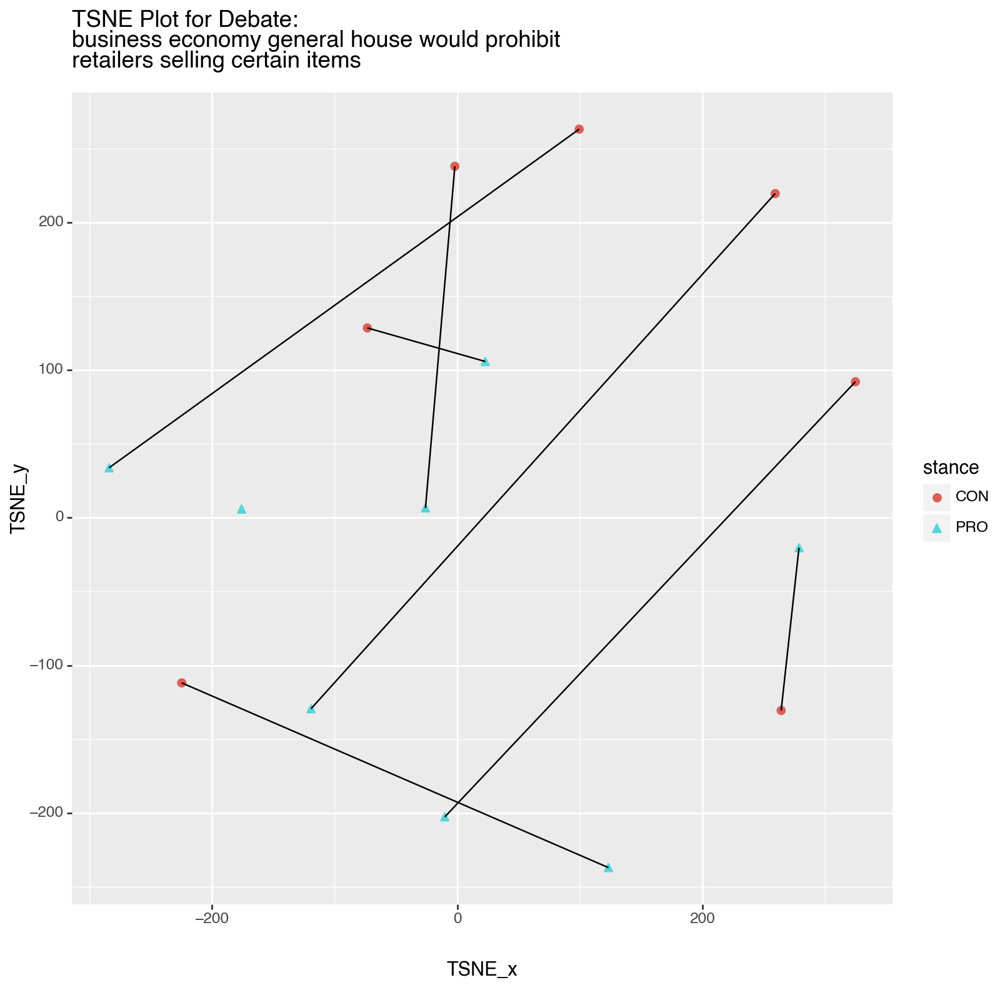

In [874]:
# Testing debate level tsne plot embeddings
debate_plot(AnalysisType.TSNE, "economy", testing_debate_tsne_embeddings)

/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 6.4 x 4.8 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/pca_plots_dump/economy/business-economy-general-house-would-prohibit-retailers-selling-certain-items_pca_plot.png


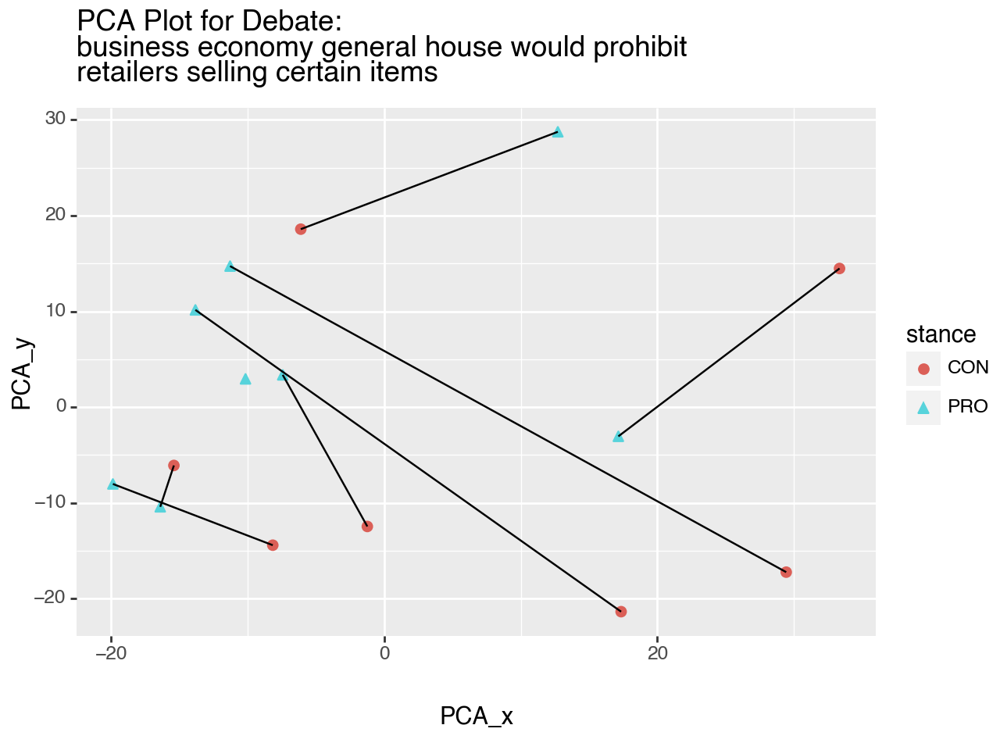

In [815]:
# Testing debate level pca plot embeddings
debate_plot(AnalysisType.PCA, "economy", testing_debate_pca_embeddings)

/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 16 x 16 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/tsne_plots_dump/economy/economy_tsne_plot.png


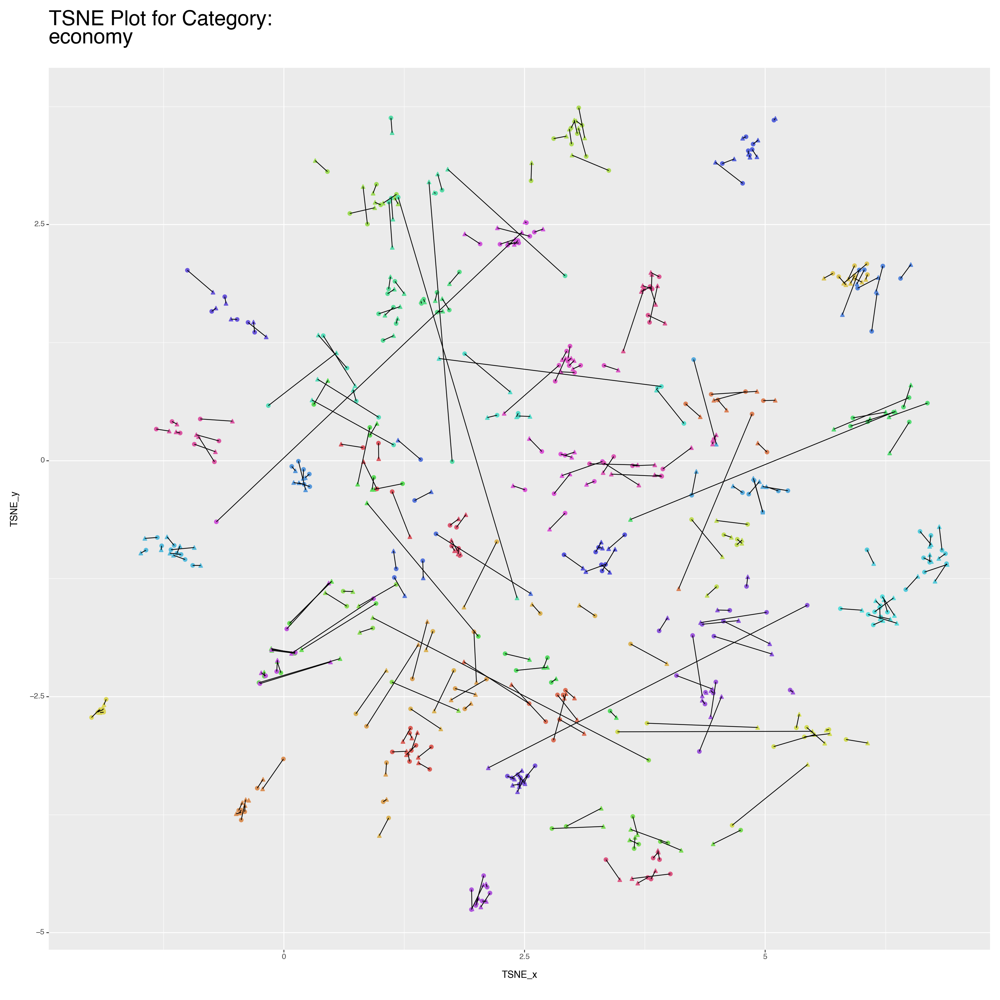

In [921]:
# Testing category level tsne plot category facet embeddings
category_plot(AnalysisType.TSNE, testing_category_tsne_category_facet_embeddings, ProcessingUnit.CATEGORY)

/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 16 x 16 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/pca_plots_dump/economy/economy_pca_plot.png


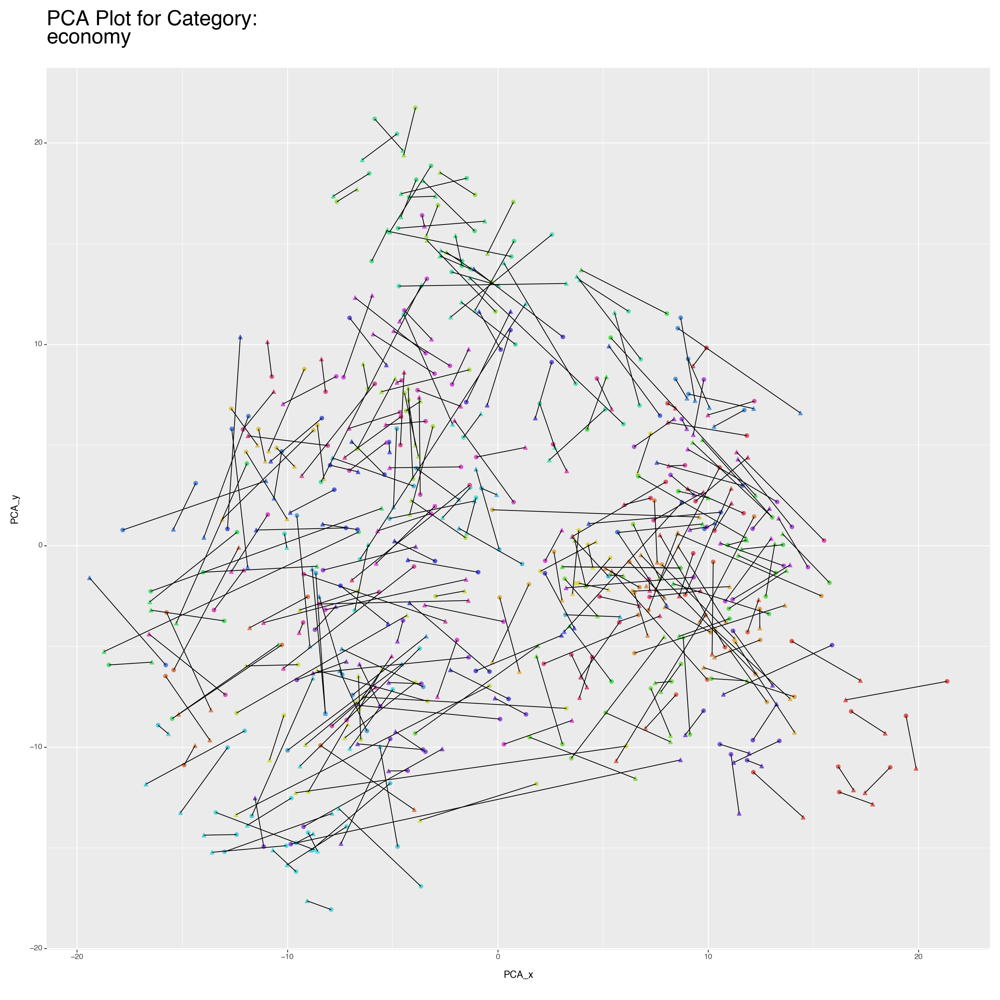

In [922]:
# Testing category level pca plot category facet embeddings
category_plot(AnalysisType.PCA, testing_category_pca_category_facet_embeddings, ProcessingUnit.CATEGORY)

/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 24 x 24 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/tsne_plots_dump/economy/economy_tsne_plot.png


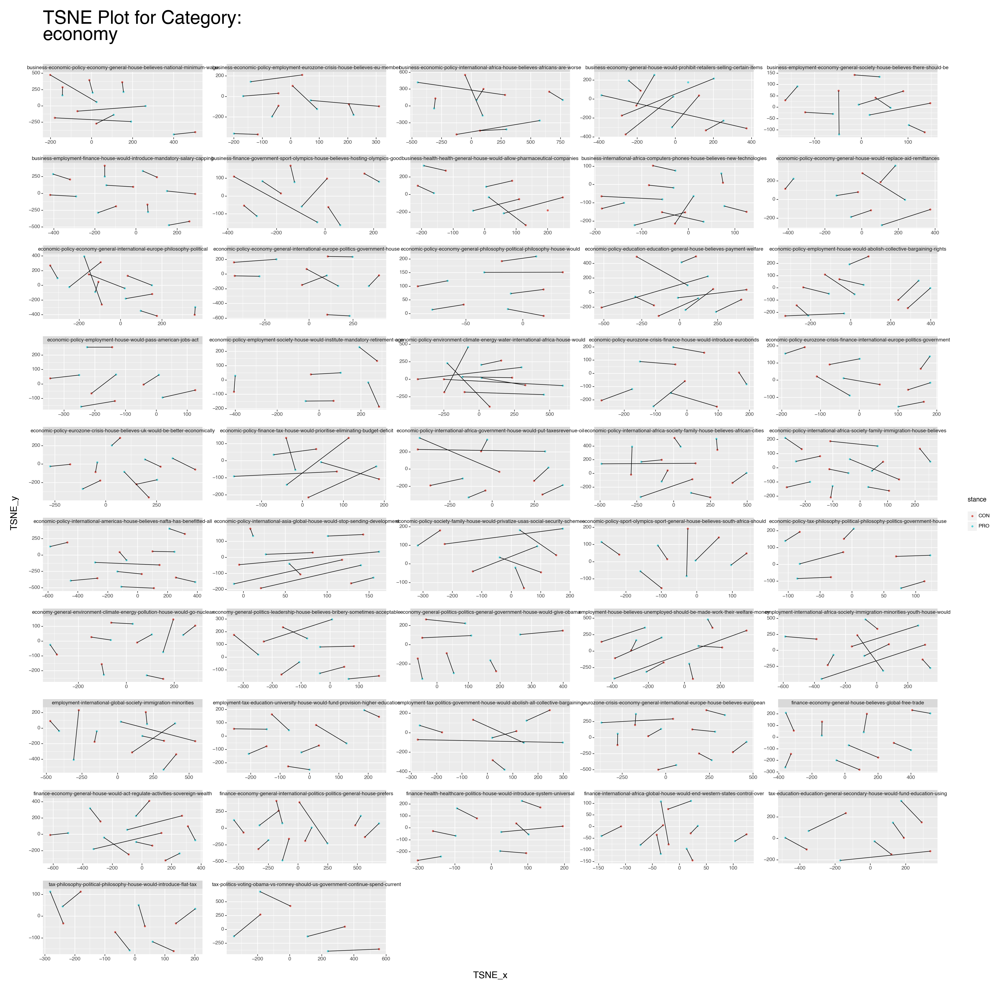

In [924]:
# Testing category level tsne plot debate facet embeddings
category_plot(AnalysisType.TSNE, testing_category_tsne_debate_facet_embeddings, ProcessingUnit.DEBATE)

/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 24 x 24 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/pca_plots_dump/economy/economy_pca_plot.png


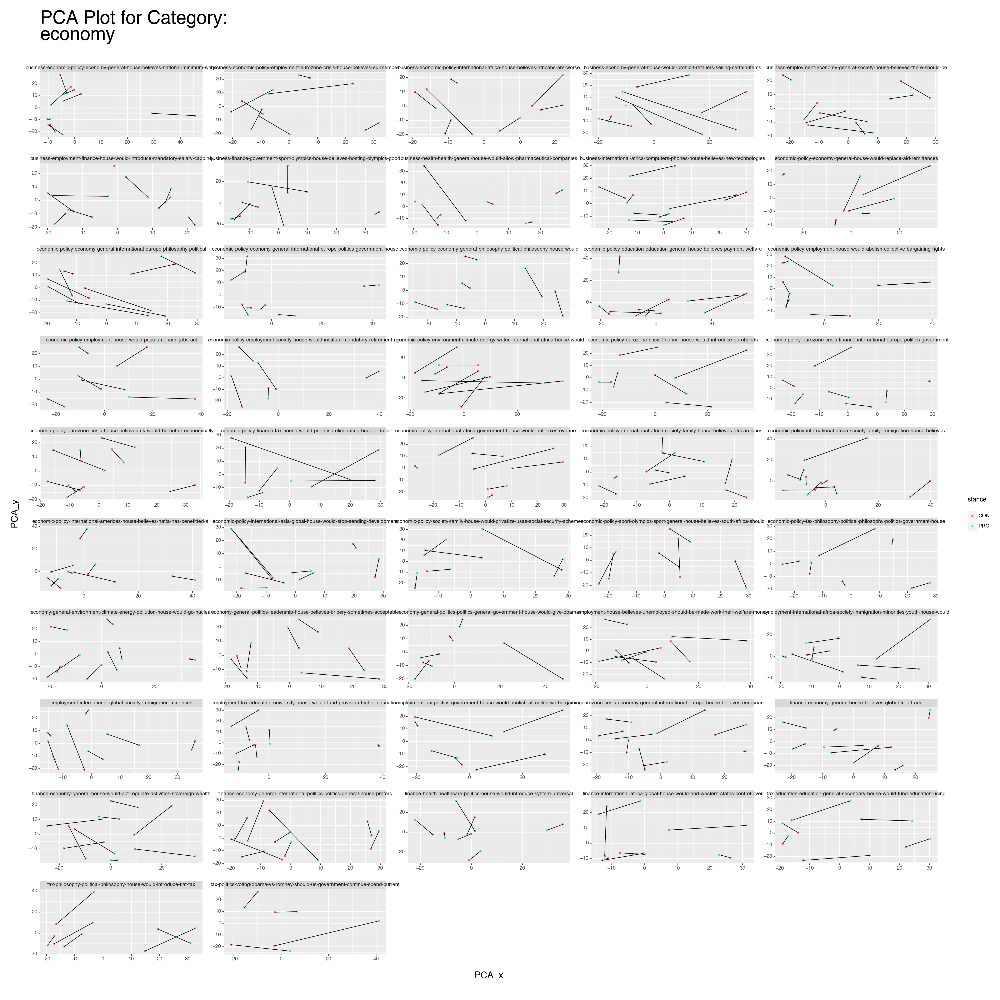

In [925]:
# Testing category level pca plot debate facet embeddings
category_plot(AnalysisType.PCA, testing_category_pca_debate_facet_embeddings, ProcessingUnit.DEBATE)

/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 24 x 24 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/tsne_plots_dump/global_tsne_plot.png


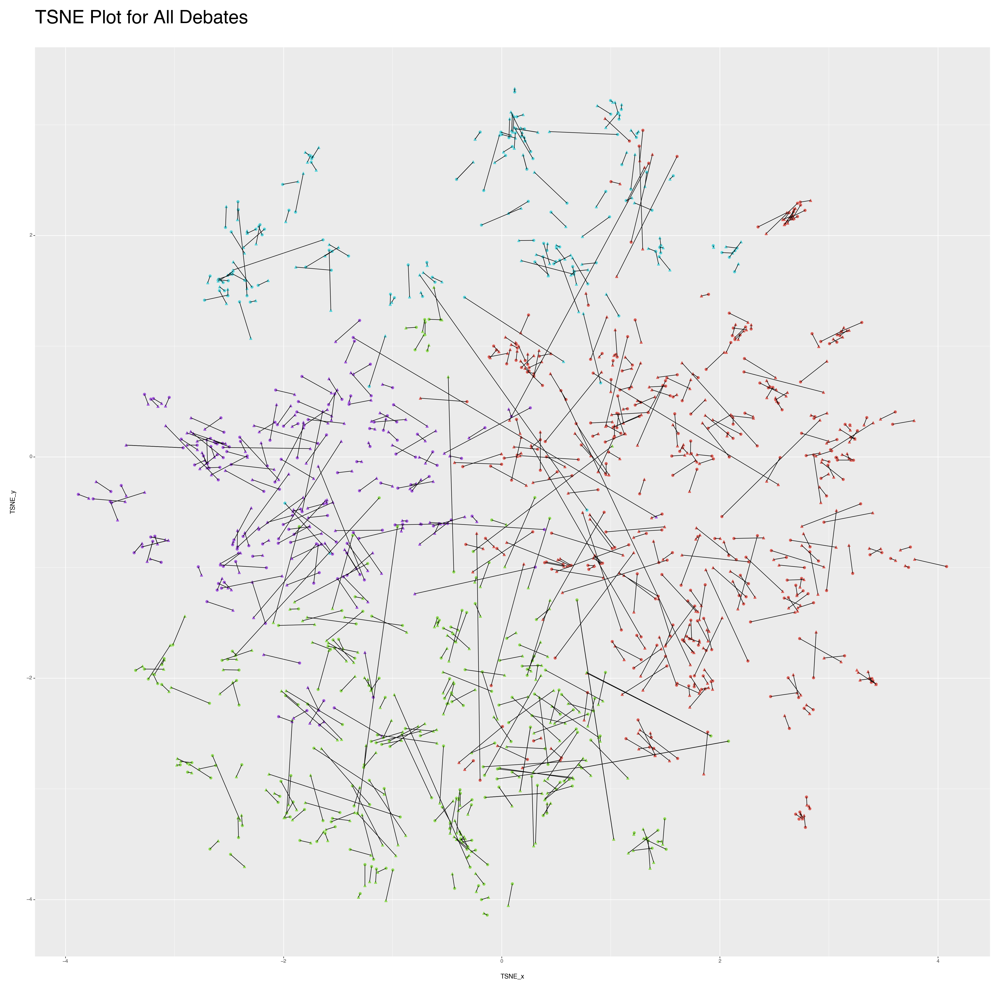

In [928]:
# Testing global level tsne plot global facet embeddings
global_plot(AnalysisType.TSNE, testing_global_tsne_global_facet_embeddings, ProcessingUnit.GLOBAL)

/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 24 x 24 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/pca_plots_dump/global_pca_plot.png


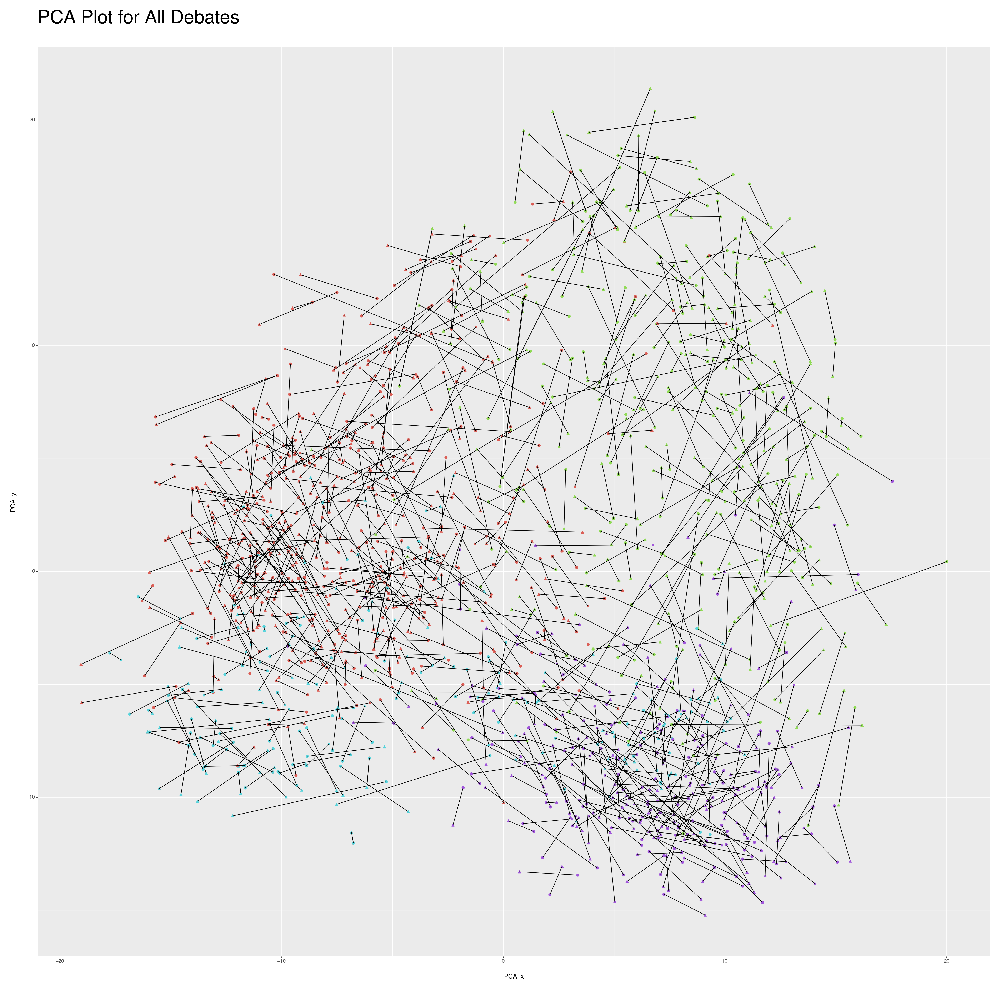

In [929]:
# Testing global level pca plot global facet embeddings
global_plot(AnalysisType.PCA, testing_global_pca_global_facet_embeddings, ProcessingUnit.GLOBAL)

/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 24 x 24 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/tsne_plots_dump/global_tsne_plot.png


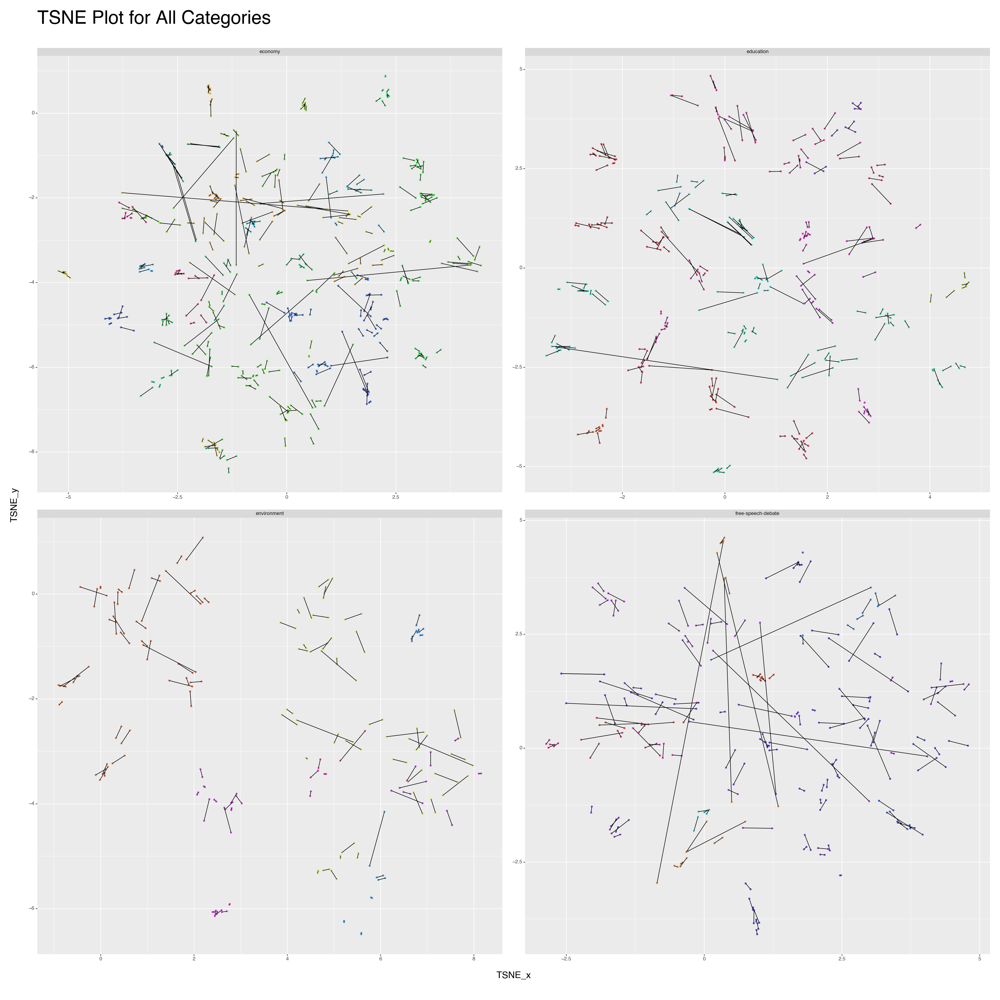

In [950]:
# Testing global level tsne plot category facet embeddings
global_plot(AnalysisType.TSNE, testing_global_tsne_category_facet_embeddings, ProcessingUnit.CATEGORY)

# Autoencoder

### Imports

In [365]:
import tensorflow as tf

Using TensorFlow backend


## Data

In [985]:
testing_global_get_embeddings_df.loc[115]

argument    Creating a mentality of illnessAdvertising to ...
pair_id                                                     4
type                                                    point
stance                                                    CON
topic       business-health-health-general-house-would-all...
                                  ...                        
1531                                                -0.019297
1532                                                 0.000581
1533                                                 0.005246
1534                                                -0.018115
1535                                                -0.046968
Name: 115, Length: 1542, dtype: object

In [1010]:
# Drop rows that do not follow 'point' -> 'counter' pattern
point_indices = testing_global_get_embeddings_df[testing_global_get_embeddings_df['type'] == 'point'].index
counter_indices = testing_global_get_embeddings_df[testing_global_get_embeddings_df['type'] == 'counter'].index
drop_indices = []
for idx in point_indices:
    if idx + 1 < len(testing_global_get_embeddings_df) and testing_global_get_embeddings_df.loc[idx + 1, 'type'] != 'counter':
        drop_indices.append(idx)
if testing_global_get_embeddings_df.loc[len(testing_global_get_embeddings_df)-1, 'type'] != 'counter':
    drop_indices.append(len(testing_global_get_embeddings_df))
for idx in counter_indices:
    if testing_global_get_embeddings_df.loc[idx - 1, 'type'] != 'point':
        drop_indices.append(idx)
    
training_df = testing_global_get_embeddings_df.drop(drop_indices)
training_df = training_df.select_dtypes(include=[np.number])
training_df.reset_index()

,index,0,1,2,3,4,5,6,7,8,...,1526,1527,1528,1529,1530,1531,1532,1533,1534,1535
0,0,-0.027132,-0.030008,0.001653,-0.041229,-0.026743,-0.013955,-0.017103,0.001876,-0.034854,...,0.011771,-0.015185,0.015224,-0.004797,-0.029593,-0.013644,-0.024916,-0.005970,-0.011421,-0.008701
1,1,-0.009182,-0.029258,0.017485,-0.039518,-0.018816,-0.011837,-0.029671,0.008749,-0.029438,...,0.012044,-0.017239,0.015701,-0.011631,-0.032979,-0.013143,-0.021646,-0.022021,-0.007043,0.002197
2,2,-0.006708,-0.030957,0.011530,-0.046931,-0.029286,-0.003127,-0.028947,0.010375,-0.029652,...,0.007217,-0.008666,0.009566,-0.008287,-0.033149,-0.025514,-0.013266,-0.013253,-0.013964,0.002690
3,3,-0.019171,-0.037232,0.031349,-0.042599,-0.039348,-0.009114,-0.033052,0.013843,-0.027892,...,0.003380,-0.004219,0.010734,-0.005222,-0.027917,-0.016578,-0.006121,-0.011804,0.006908,-0.008915
4,4,-0.027359,-0.028944,0.011335,-0.052978,-0.025294,-0.003056,-0.017057,0.001629,-0.022059,...,-0.003314,-0.018941,0.002118,-0.004102,-0.034712,-0.032556,-0.015576,-0.018941,-0.001668,0.008386
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1713,1715,-0.013297,-0.000976,0.024605,-0.033071,-0.016395,0.003088,-0.023509,-0.000876,0.007567,...,0.014814,-0.012488,0.030241,-0.010148,-0.010684,0.003573,0.005457,-0.014164,0.006365,-0.025778
1714,1716,-0.006741,-0.001408,-0.022328,-0.029211,-0.023387,-0.002521,-0.008368,-0.002529,-0.002720,...,0.035306,0.020197,0.020404,-0.002554,-0.027067,0.009123,0.013094,-0.005485,0.001129,-0.009356
1715,1717,0.011382,0.010711,-0.002461,-0.037899,-0.009335,0.016744,-0.007187,0.006572,0.000507,...,0.029229,0.020255,0.028139,-0.005019,-0.022385,-0.006952,0.008930,0.003704,0.015667,-0.016047
1716,1718,-0.010578,0.001355,0.003181,-0.023073,-0.024826,0.019364,-0.010067,-0.001798,-0.004526,...,0.027955,-0.010496,0.001506,0.005172,-0.017888,0.020020,-0.006762,-0.010155,0.009789,-0.022959


In [1088]:
# Make training and testing datasets
cutoff = int(0.8 * training_df.shape[0])

train_rows_df = training_df.iloc[:cutoff, :]
test_rows_df = training_df.iloc[cutoff:, :]

x_train = train_rows_df[train_rows_df.index % 2 == 0].reset_index(drop=True)
y_train = train_rows_df[train_rows_df.index % 2 != 0].reset_index(drop=True)

x_test = test_rows_df[test_rows_df.index % 2 == 0].reset_index(drop=True)
y_test = test_rows_df[test_rows_df.index % 2 != 0].reset_index(drop=True)

## Model

In [1089]:
# Layers
input_layer = tf.keras.layers.Input(shape=(1536, ), name="Input")
hidden_layer = tf.keras.layers.Dense(units=1536, activation="relu", name="Hidden")(input_layer)
output_layer = tf.keras.layers.Dense(units=1536, activation="linear", name="Output")(hidden_layer)

In [1090]:
# Model
autoencoder_model = tf.keras.Model(inputs=input_layer, outputs=output_layer)
autoencoder_model.summary()

Model: "model_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input (InputLayer)          [(None, 1536)]            0         
                                                                 
 Hidden (Dense)              (None, 1536)              2360832   
                                                                 
 Output (Dense)              (None, 1536)              2360832   
                                                                 
Total params: 4721664 (18.01 MB)
Trainable params: 4721664 (18.01 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [1091]:
# Compile
autoencoder_model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3),
    loss="mse",
    metrics=['accuracy']
)

In [1092]:
# Fit
autoencoder_model.fit(
    x=x_train,
    y=y_train,
    batch_size=1,
    epochs=5
)

Epoch 1/5
687/687 [==============================] - 32s 46ms/step - loss: 1.8916e-04 - accuracy: 0.9971
Epoch 2/5
687/687 [==============================] - 31s 45ms/step - loss: 1.4187e-04 - accuracy: 1.0000
Epoch 3/5
687/687 [==============================] - 31s 45ms/step - loss: 1.2689e-04 - accuracy: 1.0000
Epoch 4/5
687/687 [==============================] - 31s 45ms/step - loss: 1.2123e-04 - accuracy: 1.0000
Epoch 5/5
687/687 [==============================] - 31s 45ms/step - loss: 1.1594e-04 - accuracy: 1.0000


## Predict

In [1166]:
# Predictions
autoencoder_predictions = autoencoder_model.predict(x_test)
autoencoder_predictions_df = pd.DataFrame(autoencoder_predictions)
# FINDING THE NEED FOR THIS LINE BELOW DROVE ME ABSOLUTELY INSANE
autoencoder_predictions_df.columns = [str(i) for i in autoencoder_predictions_df.columns]

6/6 [==============================] - 0s 7ms/step


## Combine Point-Counter Dataframes

In [1188]:
""" 
Josh: I have them as separate dfs now, and they are TSNE or PCA'ed separately, so different values get generated for x_test.
Would it make more sense to combine them into one df so that each data point in x_test ends up having two lines going out to prediction vs y_test?
"""

" \nJosh: I have them as separate dfs now, and they are TSNE or PCA'ed separately, so different values get generated for x_test.\nWould it make more sense to combine them into one df so that each data point in x_test ends up having two lines going out to prediction vs y_test?\n"

In [1191]:
# Combine x_test and y_test
y_test_df = y_test.copy().astype(np.float32)
y_test_df['pair_id'] = y_test_df.index.astype(str)
y_test_df['type'] = 'counter'
x_y_test_combined_df = pd.concat([x_test_df, y_test_df], axis=0, ignore_index=True)
x_y_test_combined_df['pred_test'] = 'test'

In [1190]:
# Combine x_test and autoencoder predictions
autoencoder_predictions_df['pair_id'] = autoencoder_predictions_df.index.astype(str)
autoencoder_predictions_df['type'] = 'counter'
x_test_df = x_test.copy().astype(np.float32)
x_test_df['pair_id'] = x_test_df.index.astype(str)
x_test_df['type'] = 'point'
autoencoder_predictions_combined_df = pd.concat([x_test_df, autoencoder_predictions_df], axis=0, ignore_index=True)
autoencoder_predictions_combined_df['pred_test'] = 'pred'

## TSNE Dataframes

In [1195]:
# TSNE x_y_test
x_y_test_combined_tsne_df = tsne_embeddings(x_y_test_combined_df)

In [1194]:
# TSNE autoencoder predictions
autoencoder_predictions_combined_tsne_df = tsne_embeddings(autoencoder_predictions_combined_df)

In [1196]:
# Combine both prediction and test tsne df
pred_test_tsne_combined_df = pd.concat([autoencoder_predictions_combined_tsne_df, x_y_test_combined_tsne_df], axis=0)

## Plot Data to Compare

In [1202]:
# Plot for prediction or test
def pred_test_plot(
        analysis_type: AnalysisType,
        pred_test_data: pd.DataFrame
    ):
    plot_analysis_type = analysis_type.value.upper()
    pred_test = pred_test_data['pred_test'].iloc[0]
    gg = (
        ggplot(pred_test_data, aes(x='x', y='y', color='type', group='pair_id')) +
        geom_point(size=2) +
        geom_line(color='black', size=0.5) +
        labs(
            title=f'{plot_analysis_type} Plot: {pred_test}',
            x=f'{plot_analysis_type}_x',
            y=f'{plot_analysis_type}_y'
        ) +
        theme(
            axis_title=element_text(margin={'t': 20}),
            figure_size=(8, 8),
        )
    )

    output_folder = f'../data_dump/{analysis_type.value}_plots_dump/'
    output_file_path = f'{output_folder}{pred_test}_{analysis_type.value}_plot.png'
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    ggsave(gg, output_file_path)
    print(gg)

In [1206]:
# Combined plot for prediction and test
def combined_pred_test_plot(
        analysis_type: AnalysisType,
        combined_pred_test_data: pd.DataFrame
    ):
    plot_analysis_type = analysis_type.value.upper()
    combined_pred_test_data['interaction'] = combined_pred_test_data['pair_id'] + '_' + combined_pred_test_data['pred_test']
    gg = (
        ggplot(combined_pred_test_data, aes(x='x', y='y', color='pred_test', shape='type', group='interaction')) +
        geom_point(size=2) +
        geom_line(color='black', size=0.5) +
        labs(
            title=f'{plot_analysis_type} Combined Plot for Predictions vs Test',
            x=f'{plot_analysis_type}_x',
            y=f'{plot_analysis_type}_y'
        ) +
        theme(
            axis_title=element_text(margin={'t': 20}),
            figure_size=(8, 8),
        )
    )

    output_folder = f'../data_dump/{analysis_type.value}_plots_dump/'
    output_file_path = f'{output_folder}combined_pred_test_{analysis_type.value}_plot.png'
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    ggsave(gg, output_file_path)
    print(gg)

/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 8 x 8 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/tsne_plots_dump/pred_tsne_plot.png


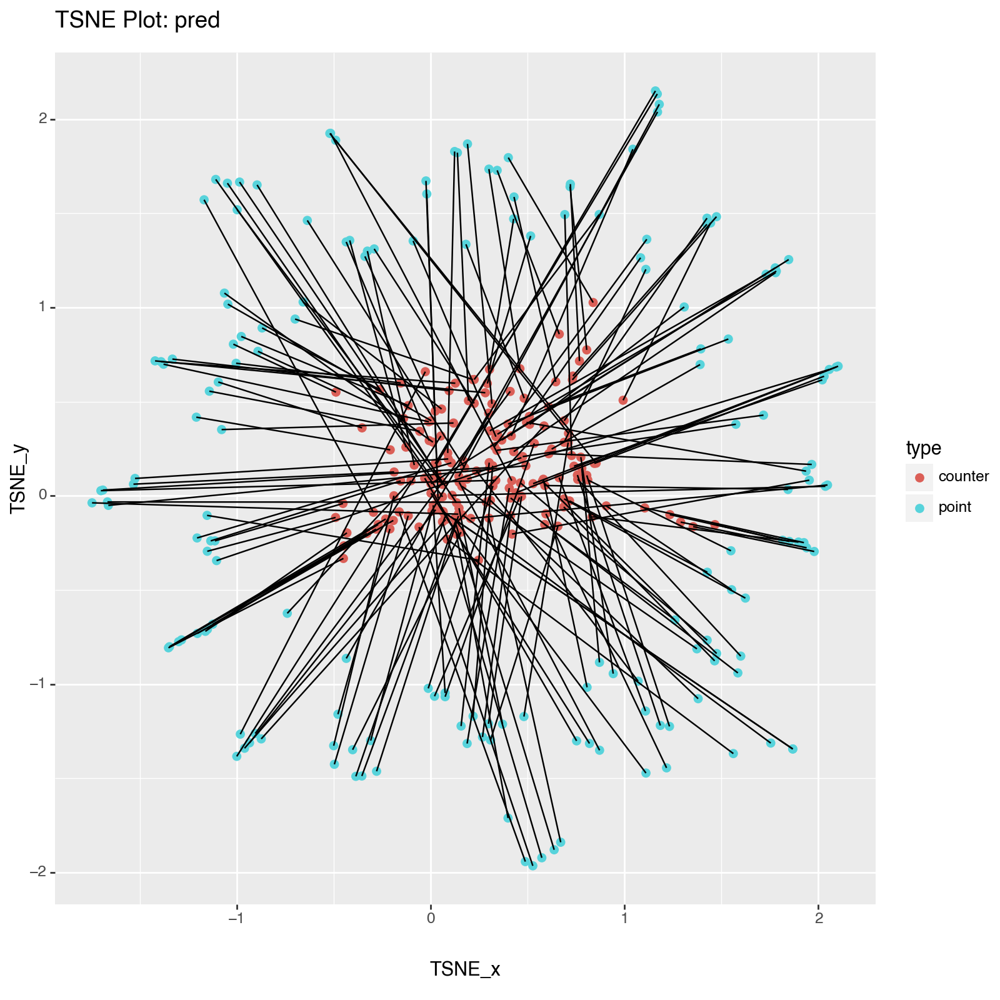

In [1203]:
# Plot TSNE autoencoder predictions
pred_test_plot(AnalysisType.TSNE, autoencoder_predictions_combined_tsne_df)

/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 8 x 8 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/tsne_plots_dump/test_tsne_plot.png


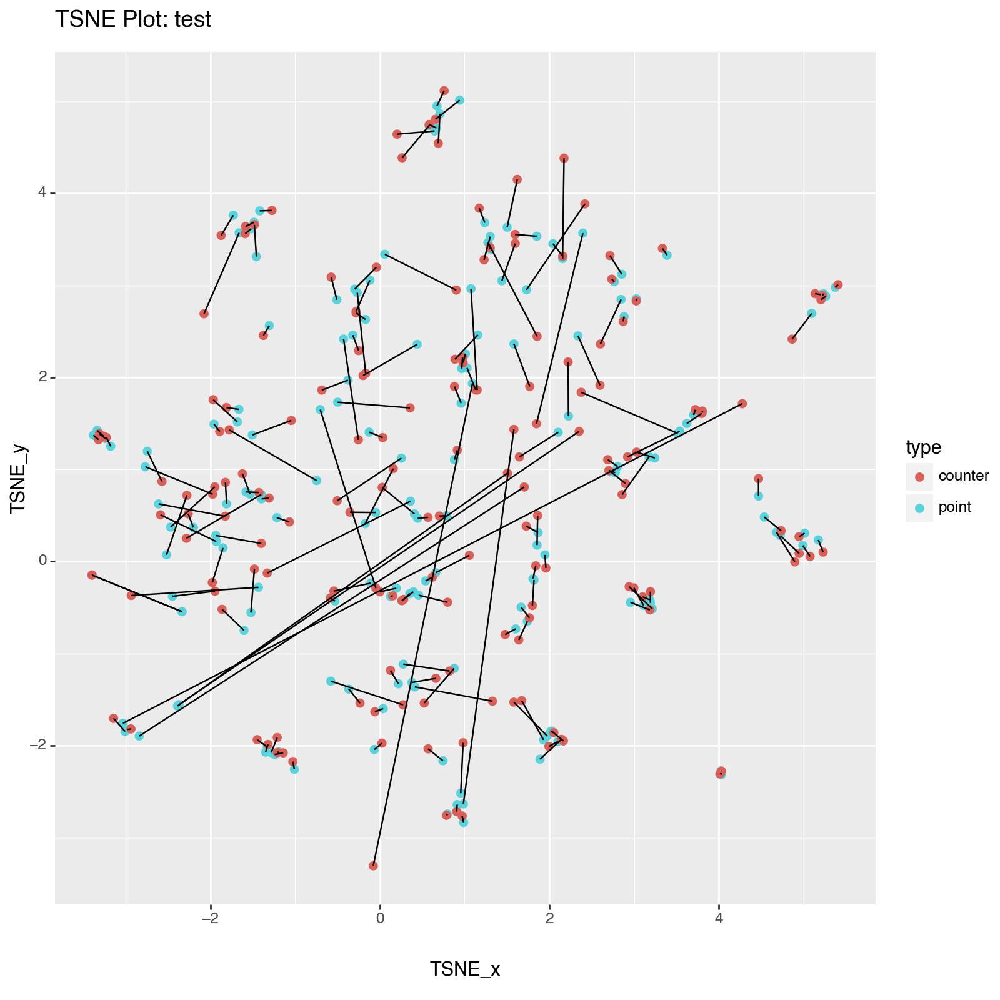

In [1204]:
# Plot TSNE test
pred_test_plot(AnalysisType.TSNE, x_y_test_combined_tsne_df)

/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 8 x 8 in image.
/usr/local/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: ../data_dump/tsne_plots_dump/combined_pred_test_tsne_plot.png


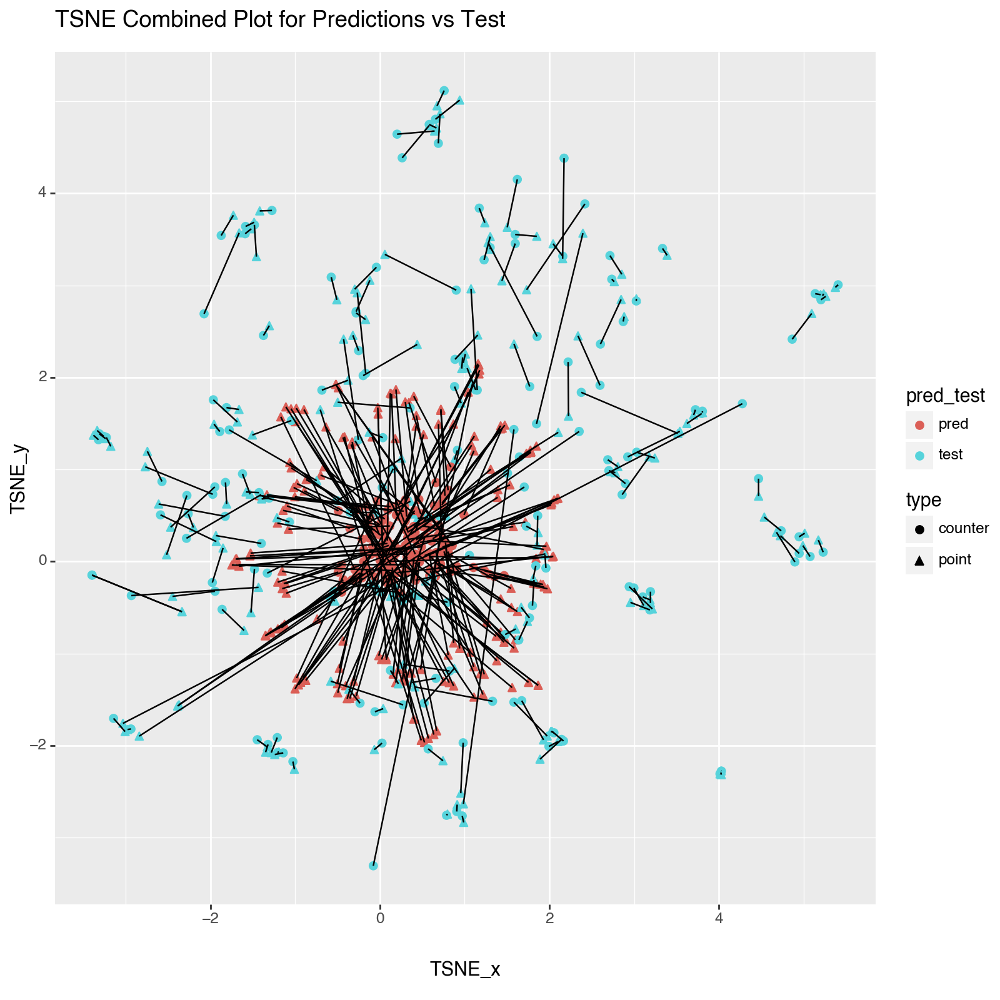

In [1207]:
# Plot combined pred-test
combined_pred_test_plot(AnalysisType.TSNE, pred_test_tsne_combined_df)